**Important:** This notebook requires the [MEME Suite](http://meme-suite.org) to be installed locally for motif discovery and scanning.

If not already installed, please follow the instructions at:  
https://meme-suite.org/meme/doc/install.html

Example (Linux/macOS):
```
wget http://meme-suite.org/meme/meme-software/5.5.3/meme-5.5.3.tar.gz
tar -xzf meme-5.5.3.tar.gz
cd meme-5.5.3
./configure --prefix=/your/installation/path
make
make install
```

You must add the `bin/` directory to your system's `PATH` for this notebook to work:
```
export PATH=/your/installation/path/bin:$PATH
```

To verify, please run the below in terminal:

which meme
which fimo

In [1]:
# Checking if MEME and FIMO is installed:

import shutil

for tool in ["meme", "fimo"]:
    if shutil.which(tool):
        print(f"{tool} found: {shutil.which(tool)}")
    else:
        print(f"{tool} not found! Please install MEME Suite and add it to your PATH.")

meme found: /Users/amritamoyade/Library/Mobile Documents/com~apple~CloudDocs/AmritaMiniProject/miniproject_env/bin/meme
fimo found: /Users/amritamoyade/Library/Mobile Documents/com~apple~CloudDocs/AmritaMiniProject/miniproject_env/bin/fimo


#### PIP installs

In [2]:
!pip install pandas
!pip install numpy
!pip install matplotlib
!pip install seaborn
!pip install scikit-learn
!pip install biopython
!pip install batchglm
!pip install inmoose
!pip install pycombat
!pip install neuroCombat
!pip install scanpy
!pip install transformers
!pip install torch
!pip install tqdm
!pip install matplotlib-venn
!pip install upsetplot


[notice] A new release of pip is available: 25.0 -> 25.0.1
[notice] To update, run: pip install --upgrade pip

[notice] A new release of pip is available: 25.0 -> 25.0.1
[notice] To update, run: pip install --upgrade pip

[notice] A new release of pip is available: 25.0 -> 25.0.1
[notice] To update, run: pip install --upgrade pip

[notice] A new release of pip is available: 25.0 -> 25.0.1
[notice] To update, run: pip install --upgrade pip

[notice] A new release of pip is available: 25.0 -> 25.0.1
[notice] To update, run: pip install --upgrade pip

[notice] A new release of pip is available: 25.0 -> 25.0.1
[notice] To update, run: pip install --upgrade pip

[notice] A new release of pip is available: 25.0 -> 25.0.1
[notice] To update, run: pip install --upgrade pip

[notice] A new release of pip is available: 25.0 -> 25.0.1
[notice] To update, run: pip install --upgrade pip

[notice] A new release of pip is available: 25.0 -> 25.0.1
[notice] To update, run: pip install --upgrade pip




[notice] A new release of pip is available: 23.3.1 -> 25.0.1
[notice] To update, run: pip install --upgrade pip

[notice] A new release of pip is available: 23.3.1 -> 25.0.1
[notice] To update, run: pip install --upgrade pip



[notice] A new release of pip is available: 23.3.1 -> 25.0.1
[notice] To update, run: pip install --upgrade pip

[notice] A new release of pip is available: 23.3.1 -> 25.0.1
[notice] To update, run: pip install --upgrade pip

[notice] A new release of pip is available: 23.3.1 -> 25.0.1
[notice] To update, run: pip install --upgrade pip


#### Imports

In [3]:
from Bio import SeqIO
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns
from scipy.stats import kurtosis, skew, anderson, normaltest
import scipy.stats as stats
from Bio import SeqIO
from sklearn.decomposition import PCA
from inmoose.pycombat import pycombat_norm, pycombat_seq
from scipy.cluster.hierarchy import dendrogram, linkage
from scipy.stats import levene, f_oneway, kruskal
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import MinMaxScaler
from pycombat import Combat
from sklearn.feature_selection import mutual_info_classif
from scipy.stats import kendalltau
from collections import Counter
from sklearn.preprocessing import LabelEncoder
from sklearn.ensemble import RandomForestClassifier
from scipy.stats import median_abs_deviation
import os
import subprocess
from sklearn.inspection import permutation_importance
import plotly.express as px
import re
from transformers import AutoTokenizer, AutoModelForMaskedLM, AutoModel
import torch
from tqdm import tqdm  # Progress bar library
from upsetplot import UpSet
from matplotlib_venn import venn3
from sklearn.metrics import r2_score, mean_squared_error
import matplotlib.pyplot as plt
import seaborn as sns
import matplotlib.cm as cm
import matplotlib.colors as mcolors

#### Load files - 3'UTR

In [4]:
file_path = "StudMAt/3UTR_sequences.fasta"

UTR3_sequences = list(SeqIO.parse(file_path, "fasta"))

print(f"ID: {UTR3_sequences[0].id}")
print(f"Sequence: {UTR3_sequences[0].seq}")

ID: ENSCGRT00001000051|ENSCGRG00001000050|Rad21
Sequence: GGAGCTGGAAGCATTAGTTCTAGTGTTTGCTCACTAGTACATACAAATTGCCCCCGTGTGTAGGGCACCAAAACCCTATAAGGAAGTTTTTAGATTTTTGTTTGTACAAAATCTTTGCCTTTTCTTTCTTCATCTCCCCCCTCCCCCCCCCCCAGTGTTTCTAATTTGTCCACCATCTTTTAAGGGAAACTGCTTATTTGGGTTGGGATTGTATTCCTGGAGAGAACAGTACCCCCAAGAACCCAGAAGACTTTTAACCAGTCAGAACAGATGTGTGCAATATTGGTGCATGAGATAATATGGAGTGATAACAGTCAGAAGTCCCCATTTTTATGTTAGTTTTCCATTGCTGTGTTGAAAGGAAAACCTGCCTAGGAAAATGCCTGACACTCTTAAGAGCTGTGGTTTGAGTCCCTTGACGGGAAGAGAAAATGTCTTCCCAGCAGTCTGGTTAACCACTGTGCCCAGGGATAGATAGCACAGGAAGCATCATGATGTCTTCTTGATCATGTTTTAAAGTAATGCCATGATGAGCAGGAATTTGTGACTTGTGTTGTGACTGACCCGCTTGGACTGTTGTGTCGTGAAATCATTCCGTGAGAGTCTCAGGCGCTCGGACATTAGTGCAGCTCAGGGTGATGAGGCTGCCGATCACTTTTTTAAAGTTGTTTGGGTATGTTTGCTTGAGTAATGCGATCATGAAAATAGAAAGTCTGCTGAAGGGCAGGCTGATGAGAAACTACACCAGGTAGACTTTGCTTTACGCAAACAGTGCTGTAAAAACTAACGGCTTCTCCGATATTTATTATAAATGTTAGTACTGATCTCTTTACAATGCTGCACACTCCTGTATTGGAAGCTTATTTTAATCGTTTCGCAACTGTAATCCTGTATCAGTTTCCTATAATTTAAATGGAGAAAAACATCAAGATAAAGGCTTTA

In [5]:
data = [{"ID": record.id, "Sequence": str(record.seq), "Length": len(record.seq)} for record in UTR3_sequences]
UTR3_sequences_df = pd.DataFrame(data)

print(UTR3_sequences_df.head(1))

                                            ID  \
0  ENSCGRT00001000051|ENSCGRG00001000050|Rad21   

                                            Sequence  Length  
0  GGAGCTGGAAGCATTAGTTCTAGTGTTTGCTCACTAGTACATACAA...    3081  


#### Load files - 5'UTR

In [6]:
file_path = "StudMAt/5UTR_sequences.fasta"

UTR5_sequences = list(SeqIO.parse(file_path, "fasta"))

print(f"ID: {UTR5_sequences[0].id}")
print(f"Sequence: {UTR5_sequences[0].seq}")

ID: ENSCGRT00001000053|ENSCGRG00001000053|Prok1
Sequence: Sequenceunavailable


In [7]:
data = [{"ID": record.id, "Sequence": str(record.seq), "Length": len(record.seq)} for record in UTR5_sequences]
UTR5_sequences_df = pd.DataFrame(data)

print(UTR5_sequences_df.head(1))

                                            ID             Sequence  Length
0  ENSCGRT00001000053|ENSCGRG00001000053|Prok1  Sequenceunavailable      19


#### Load files - CDS

In [8]:
file_path = "StudMAt/CDS_sequences.fasta"

CDS_sequences = list(SeqIO.parse(file_path, "fasta"))

print(f"ID: {CDS_sequences[0].id}")
print(f"Sequence: {CDS_sequences[0].seq}")

ID: ENSCGRT00001000053|ENSCGRG00001000053|Prok1
Sequence: CTGAGAGCTTCTGTGTTTGTCCTGAAGACCAAGGCCTGTGACCGAGATGTCCAGTGTGGGCCGGGCACGTGCTGTGCTATCAGCCTGTGGCTGCGGGGGCTGCGGTTGTGTACCCCACTGGGGAGGGAAGGAGAGGAGTGCCACCCAGGAAGCCACAAGATCCCTTTCTTTAGGAAACGCCAGCACCATGCCTGTCCCTGCTCACGCAGCCTGCTGTGCTCCAGGTTTCTGGATGGCAGGTACCGCTGTTCCCGGGACTTGAAGAACGTCAACTTTTAG


In [9]:
data = [{"ID": record.id, "Sequence": str(record.seq), "Length": len(record.seq)} for record in CDS_sequences]
CDS_sequences_df = pd.DataFrame(data)

print(CDS_sequences_df.head(1))

                                            ID  \
0  ENSCGRT00001000053|ENSCGRG00001000053|Prok1   

                                            Sequence  Length  
0  CTGAGAGCTTCTGTGTTTGTCCTGAAGACCAAGGCCTGTGACCGAG...     279  


#### Load files - Expression

In [10]:
expression_file = "StudMAt/expression_counts.txt"
expression_df = pd.read_csv(expression_file, sep="\t")
print(expression_df.head(1))

  ensembl_transcript_id                 sym ensembl_peptide_id  SRR3401749  \
0    ENSCGRT00001000001  ENSCGRG00001000001         non-coding         0.0   

   SRR3401751  SRR3401745  SRR3401747  SRR3401746  SRR3401748  SRR3401750  \
0         0.0         0.0         0.0         0.0         0.0         0.0   

   ...  SRR18502238  SRR18502234  SRR18502235  SRR18502236  SRR18502224  \
0  ...          0.0          0.0          0.0          0.0          0.0   

   SRR18502225  SRR18502226  SRR18502229  SRR18502230  SRR18502233  
0          0.0          0.0          0.0          0.0          0.0  

[1 rows x 83 columns]


#### Load files - Manifest

In [11]:
manifest_file = "StudMAt/MANIFEST.txt"
manifest_df = pd.read_csv(manifest_file, sep="\t")
print(manifest_df.head())

  Experiment      Sample                                        description
0  SRP073484  SRR3401749  Illumina HiSeq 2000 sequencing: RNA-Seq of CHO...
1  SRP073484  SRR3401751  Illumina HiSeq 2000 sequencing: RNA-Seq of CHO...
2  SRP073484  SRR3401745  Illumina HiSeq 2000 sequencing: RNA-Seq of CHO...
3  SRP073484  SRR3401747  Illumina HiSeq 2000 sequencing: RNA-Seq of CHO...
4  SRP073484  SRR3401746  Illumina HiSeq 2000 sequencing: RNA-Seq of CHO...


#### File information

In [12]:
print(UTR3_sequences_df.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 32575 entries, 0 to 32574
Data columns (total 3 columns):
 #   Column    Non-Null Count  Dtype 
---  ------    --------------  ----- 
 0   ID        32575 non-null  object
 1   Sequence  32575 non-null  object
 2   Length    32575 non-null  int64 
dtypes: int64(1), object(2)
memory usage: 763.6+ KB
None


In [13]:
print(UTR5_sequences_df.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 32575 entries, 0 to 32574
Data columns (total 3 columns):
 #   Column    Non-Null Count  Dtype 
---  ------    --------------  ----- 
 0   ID        32575 non-null  object
 1   Sequence  32575 non-null  object
 2   Length    32575 non-null  int64 
dtypes: int64(1), object(2)
memory usage: 763.6+ KB
None


In [14]:
print(CDS_sequences_df.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 32575 entries, 0 to 32574
Data columns (total 3 columns):
 #   Column    Non-Null Count  Dtype 
---  ------    --------------  ----- 
 0   ID        32575 non-null  object
 1   Sequence  32575 non-null  object
 2   Length    32575 non-null  int64 
dtypes: int64(1), object(2)
memory usage: 763.6+ KB
None


In [15]:
print(expression_df.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 32576 entries, 0 to 32575
Data columns (total 83 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   ensembl_transcript_id  32576 non-null  object 
 1   sym                    32576 non-null  object 
 2   ensembl_peptide_id     32576 non-null  object 
 3   SRR3401749             32576 non-null  float64
 4   SRR3401751             32576 non-null  float64
 5   SRR3401745             32576 non-null  float64
 6   SRR3401747             32576 non-null  float64
 7   SRR3401746             32576 non-null  float64
 8   SRR3401748             32576 non-null  float64
 9   SRR3401750             32576 non-null  float64
 10  SRR3401752             32576 non-null  float64
 11  ERR7417863             32576 non-null  float64
 12  ERR7417867             32576 non-null  float64
 13  ERR7417864             32576 non-null  float64
 14  ERR7417870             32576 non-null  float64
 15  ER

In [16]:
print(manifest_df.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 80 entries, 0 to 79
Data columns (total 3 columns):
 #   Column       Non-Null Count  Dtype 
---  ------       --------------  ----- 
 0   Experiment   80 non-null     object
 1   Sample       80 non-null     object
 2   description  80 non-null     object
dtypes: object(3)
memory usage: 2.0+ KB
None


#### Statistical descriptions

In [17]:
print(expression_df.describe())

          SRR3401749     SRR3401751     SRR3401745     SRR3401747  \
count   32576.000000   32576.000000   32576.000000   32576.000000   
mean      339.058386     353.207729     325.181361     353.520844   
std      2342.894138    1926.955226    1671.769347    1892.039246   
min         0.000000       0.000000       0.000000       0.000000   
25%         0.000000       0.000000       0.000000       0.000000   
50%         1.000000       0.000000       0.000000       0.000000   
75%       195.000000     219.000000     185.000000     226.515000   
max    210280.000000  162467.000000  126340.000000  165165.000000   

          SRR3401746     SRR3401748     SRR3401750     SRR3401752  \
count   32576.000000   32576.000000   32576.000000   32576.000000   
mean      375.284841     315.875583     340.246562     324.167362   
std      2290.589339    2274.782742    2633.556341    2159.894125   
min         0.000000       0.000000       0.000000       0.000000   
25%         0.000000       0.0000

In [18]:
print(UTR3_sequences_df.describe())

             Length
count  32575.000000
mean     306.390944
std      825.437697
min        1.000000
25%       19.000000
50%       19.000000
75%       19.000000
max     4999.000000


In [19]:
print(UTR5_sequences_df.describe())

             Length
count  32575.000000
mean      76.082425
std      174.793391
min        1.000000
25%       19.000000
50%       19.000000
75%       19.000000
max     6845.000000


In [20]:
print(CDS_sequences_df.describe())

             Length
count  32575.000000
mean    1484.131512
std     1644.150334
min       19.000000
25%      525.000000
50%     1065.000000
75%     1902.000000
max    24102.000000


#### Missing values check

In [21]:
print(UTR3_sequences_df.isnull().sum())

ID          0
Sequence    0
Length      0
dtype: int64


In [22]:
print(UTR5_sequences_df.isnull().sum())

ID          0
Sequence    0
Length      0
dtype: int64


In [23]:
print(CDS_sequences_df.isnull().sum())

ID          0
Sequence    0
Length      0
dtype: int64


In [24]:
print(manifest_df.isnull().sum())

Experiment     0
Sample         0
description    0
dtype: int64


In [25]:
# print((expression_df == 0).sum())

In [26]:
print(expression_df.isnull().sum()[expression_df.isnull().sum() > 0])

Series([], dtype: int64)


#### 3'UTR Sequence Length Distribution Graph

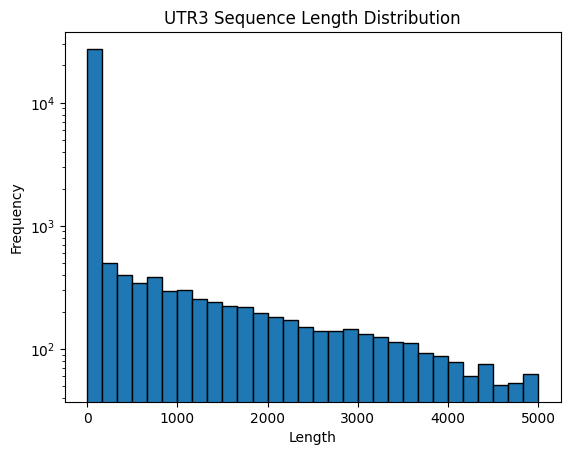

In [27]:
plt.hist(UTR3_sequences_df["Length"], bins=30, edgecolor='k')
plt.title("UTR3 Sequence Length Distribution")
plt.xlabel("Length")
plt.ylabel("Frequency")
plt.yscale("log")
plt.show()

#### 5'UTR Sequence Length Distribution Graph

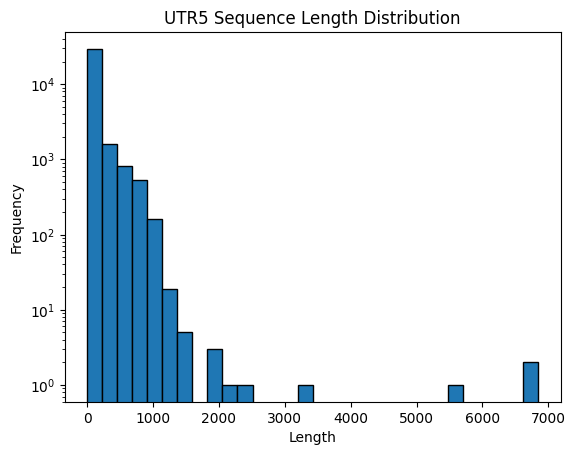

In [28]:
plt.hist(UTR5_sequences_df["Length"], bins=30, edgecolor='k')
plt.title("UTR5 Sequence Length Distribution")
plt.xlabel("Length")
plt.ylabel("Frequency")
plt.yscale("log")
plt.show()

#### CDS Sequence Length Distribution Graph

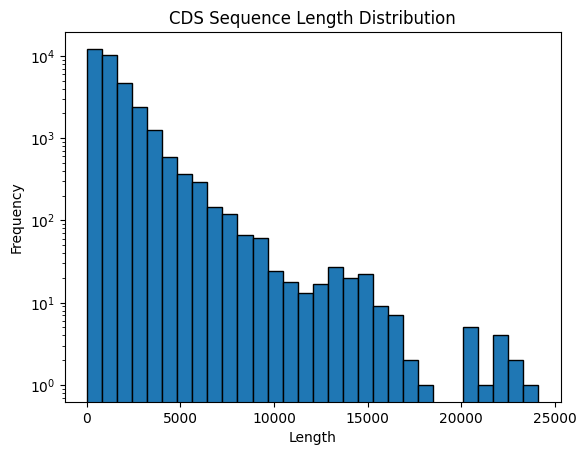

In [29]:
plt.hist(CDS_sequences_df["Length"], bins=30, edgecolor='k')
plt.title("CDS Sequence Length Distribution")
plt.xlabel("Length")
plt.ylabel("Frequency")
plt.yscale("log")
plt.show()

#### Sequence's QQ Plot

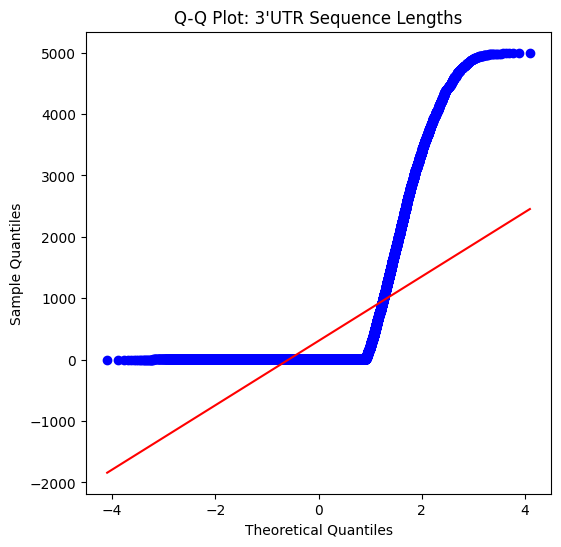

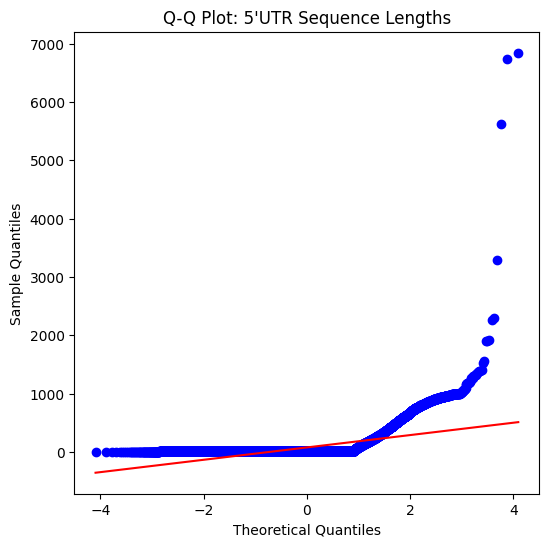

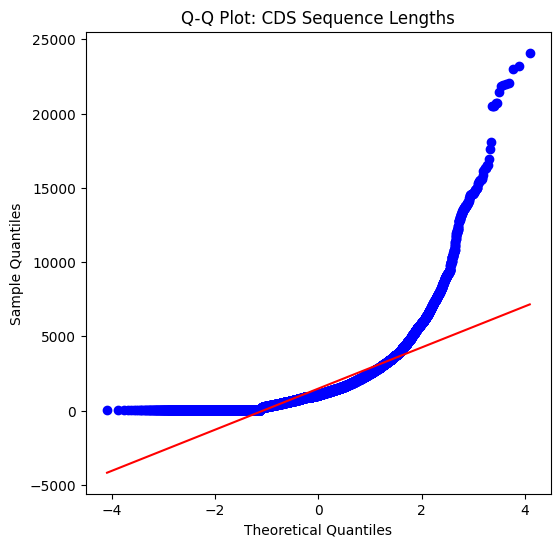

In [30]:
def plot_qq(data, title):
    plt.figure(figsize=(6, 6))
    
    # Generate Q-Q plot
    stats.probplot(data, dist="norm", plot=plt)
    
    plt.title(f"Q-Q Plot: {title}")
    plt.xlabel("Theoretical Quantiles")
    plt.ylabel("Sample Quantiles")
    
    plt.show()

# Generate Q-Q plots for each dataset
plot_qq(UTR3_sequences_df["Length"], "3'UTR Sequence Lengths")
plot_qq(UTR5_sequences_df["Length"], "5'UTR Sequence Lengths")
plot_qq(CDS_sequences_df["Length"], "CDS Sequence Lengths")

#### Kurtosis and Skewness

In [31]:
def compute_kurtosis_skewness(data, label):
    skewness = skew(data)
    kurt = kurtosis(data)
    print(f"{label} - Skewness: {skewness:.5f}, Kurtosis: {kurt:.5f}")

compute_kurtosis_skewness(UTR3_sequences_df["Length"], "3'UTR")
compute_kurtosis_skewness(UTR5_sequences_df["Length"], "5'UTR")
compute_kurtosis_skewness(CDS_sequences_df["Length"], "CDS")

3'UTR - Skewness: 3.34327, Kurtosis: 11.10698
5'UTR - Skewness: 7.66033, Kurtosis: 179.92882
CDS - Skewness: 3.65528, Kurtosis: 24.07727


#### Data Normality Test

In [32]:
def normality_tests(data, label):

    # Anderson-Darling Test (Good for heavy tails)
    result = anderson(data, dist='norm')
    print(f"Anderson-Darling Test Statistic: {result.statistic:.5f}")
    for i in range(len(result.critical_values)):
        sig_level = result.significance_level[i]
        crit_value = result.critical_values[i]
        print(f"  {sig_level}% significance level - Critical value: {crit_value:.5f}")
        print(" Normal" if result.statistic < crit_value else " Not Normal")

    # D’Agostino & Pearson’s Test (Detects skewness & kurtosis)
    stat, p = normaltest(data)
    print(f"D'Agostino & Pearson’s Test: p-value = {p:.5f}")
    print(" Normal" if p > 0.05 else " Not Normal")

normality_tests(UTR3_sequences_df["Length"], "3'UTR Sequence Lengths")

Anderson-Darling Test Statistic: 8570.71400
  15.0% significance level - Critical value: 0.57600
 Not Normal
  10.0% significance level - Critical value: 0.65600
 Not Normal
  5.0% significance level - Critical value: 0.78700
 Not Normal
  2.5% significance level - Critical value: 0.91800
 Not Normal
  1.0% significance level - Critical value: 1.09200
 Not Normal
D'Agostino & Pearson’s Test: p-value = 0.00000
 Not Normal


In [33]:
normality_tests(UTR5_sequences_df["Length"], "5'UTR Sequence Lengths")

Anderson-Darling Test Statistic: 8158.16768
  15.0% significance level - Critical value: 0.57600
 Not Normal
  10.0% significance level - Critical value: 0.65600
 Not Normal
  5.0% significance level - Critical value: 0.78700
 Not Normal
  2.5% significance level - Critical value: 0.91800
 Not Normal
  1.0% significance level - Critical value: 1.09200
 Not Normal
D'Agostino & Pearson’s Test: p-value = 0.00000
 Not Normal


In [34]:
normality_tests(CDS_sequences_df["Length"], "CDS Sequence Lengths")

Anderson-Darling Test Statistic: 1879.68243
  15.0% significance level - Critical value: 0.57600
 Not Normal
  10.0% significance level - Critical value: 0.65600
 Not Normal
  5.0% significance level - Critical value: 0.78700
 Not Normal
  2.5% significance level - Critical value: 0.91800
 Not Normal
  1.0% significance level - Critical value: 1.09200
 Not Normal
D'Agostino & Pearson’s Test: p-value = 0.00000
 Not Normal


In [35]:
manifest_PCA_df = manifest_df.set_index("Sample")
expression_PCA_df = expression_df.iloc[:, 3:]

In [36]:
expression_PCA_df = np.log2(expression_PCA_df+1)

In [37]:
expression_PCA_df

,SRR3401749,SRR3401751,SRR3401745,SRR3401747,SRR3401746,SRR3401748,SRR3401750,SRR3401752,ERR7417863,ERR7417867,...,SRR18502238,SRR18502234,SRR18502235,SRR18502236,SRR18502224,SRR18502225,SRR18502226,SRR18502229,SRR18502230,SRR18502233
0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
1,12.075479,10.861087,10.491853,11.925184,12.054604,12.520619,12.284824,10.997179,11.447600,11.624339,...,10.684749,11.115694,10.575539,9.965784,11.865347,11.476746,12.000704,10.893302,10.345405,10.488844
2,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
3,13.162706,12.267079,12.928518,12.784430,13.874021,12.930183,13.675957,12.046442,12.039605,13.022541,...,12.370415,12.382624,11.647458,11.578844,13.068778,12.794619,13.241238,12.345682,12.091105,11.713816
4,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,...,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
32571,8.864186,7.741467,8.066089,7.839204,8.665336,8.257388,10.002815,8.071462,7.228819,8.271463,...,8.339850,8.491853,8.366322,8.233620,9.002815,9.400879,8.861087,8.027906,7.832890,8.519636
32572,1.009347,1.009347,0.000000,1.009347,0.000000,0.000000,1.009347,1.008630,0.000000,0.000000,...,2.005041,0.000000,2.812704,0.000000,1.002162,0.000000,2.006837,2.005400,1.588805,1.002883
32573,0.000000,0.000000,8.199672,1.000000,8.965784,0.000000,0.000000,1.000000,8.845490,7.247928,...,7.098032,7.491853,6.189825,6.700440,6.857981,6.870365,6.870365,7.845490,7.727920,7.066089
32574,10.747354,11.351491,11.199672,11.314583,12.121534,11.718533,10.759056,11.875365,11.847449,11.792790,...,11.353147,11.403545,11.281351,11.038233,10.894060,10.764872,10.923327,11.300924,10.795228,11.213712


In [38]:
scaler = StandardScaler()
expression_PCA_scaled = scaler.fit_transform(expression_PCA_df)

In [39]:
expression_PCA_df = pd.DataFrame(expression_PCA_scaled, index=expression_PCA_df.index, columns=expression_PCA_df.columns)

In [40]:
expression_PCA_df = expression_PCA_df.T  # Transposing so samples are rows

In [41]:
expression_PCA_df = expression_PCA_df.loc[manifest_PCA_df.index]  # Aligning with manifest

In [42]:
expression_PCA_df["Batch"] = manifest_PCA_df["Experiment"]

In [43]:
pca = PCA(n_components=2)
pca_result = pca.fit_transform(expression_PCA_df.drop(columns=["Batch"]))

In [44]:
pca_df = pd.DataFrame(pca_result, columns=["PC1", "PC2"])
pca_df["Batch"] = expression_PCA_df["Batch"].values

#### PCA Plot

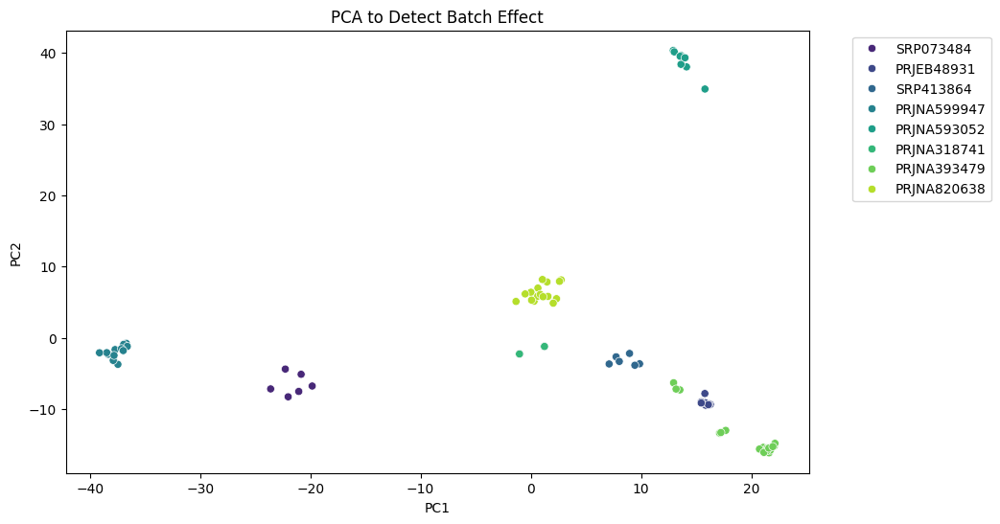

In [45]:
plt.figure(figsize=(10, 6))
sns.scatterplot(x="PC1", y="PC2", hue="Batch", data=pca_df, palette="viridis")
plt.title("PCA to Detect Batch Effect")
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.show()


#### Hierarchical Clustering by Batch to detect batch effect before and after correction

In [46]:
linkage_matrix = linkage(expression_PCA_df.drop(columns=["Batch"]), method='ward')

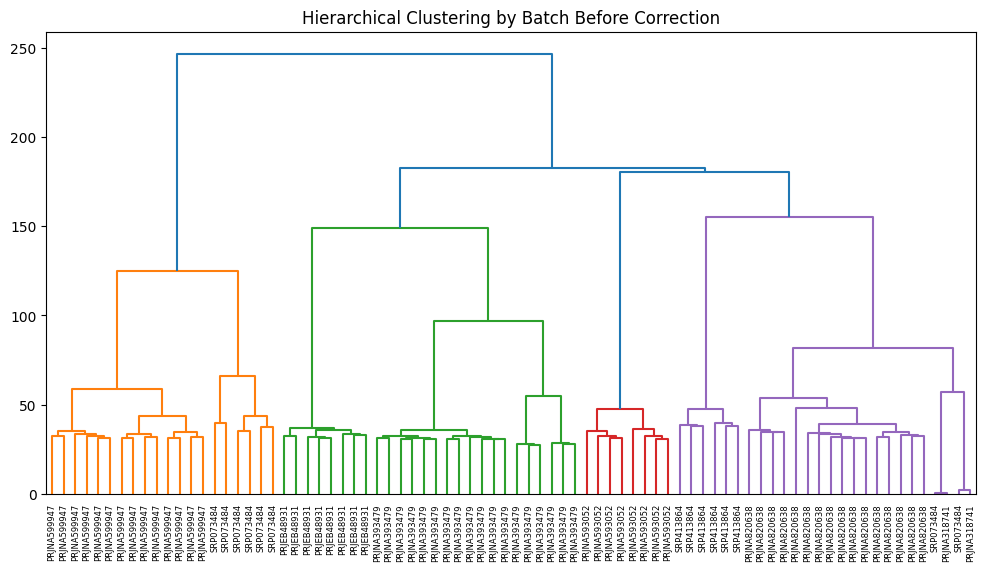

In [47]:
plt.figure(figsize=(12, 6))
dendrogram(linkage_matrix, labels=expression_PCA_df["Batch"].values, leaf_rotation=90)
plt.title("Hierarchical Clustering by Batch Before Correction")
plt.show()

In [48]:
variance_df = expression_PCA_df.drop(columns=["Batch"]).var(axis=1)
batch_variance_df = pd.DataFrame({"Variance": variance_df, "Batch": expression_PCA_df["Batch"]})

#### Batch-wise Variance Analysis

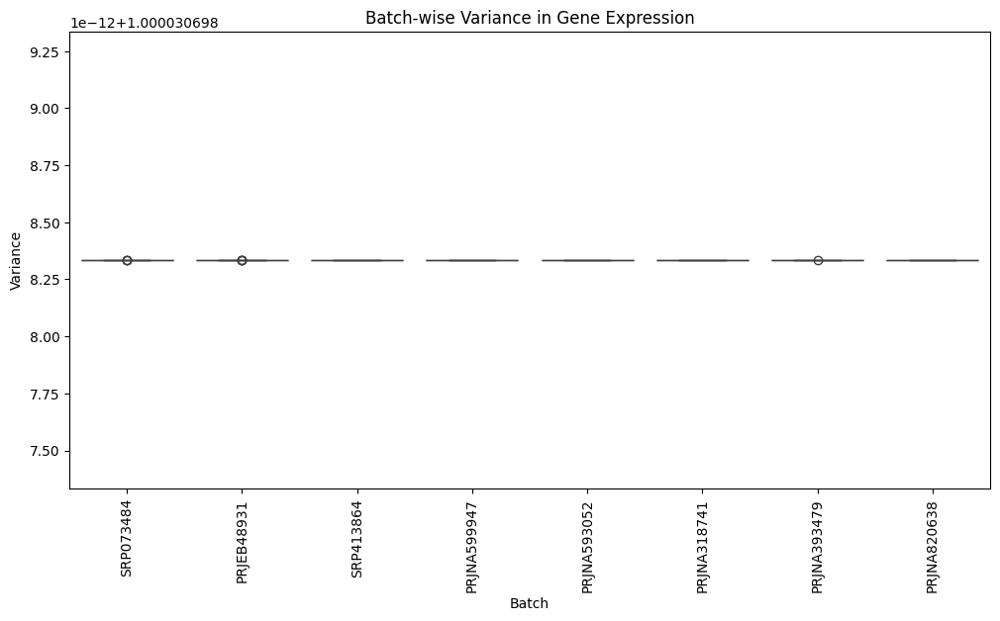

In [49]:
# Boxplot of variance per batch
plt.figure(figsize=(12, 6))
sns.boxplot(x="Batch", y="Variance", data=batch_variance_df)
plt.xticks(rotation=90)
plt.title("Batch-wise Variance in Gene Expression")
plt.show()

## Batch Effect Correction: pycombat

In [50]:
expression_PCA_df

,0,1,2,3,4,5,6,7,8,9,...,32567,32568,32569,32570,32571,32572,32573,32574,32575,Batch
Sample,,,,,,,,,,,,,,,,,,,,,
SRR3401749,-0.862044,2.090503,-0.862044,2.356339,-0.862044,3.025205,-0.862044,-0.862044,-0.862044,3.253146,...,1.605066,-0.862044,-0.128521,-0.862044,1.305318,-0.615250,-0.862044,1.765767,3.277041,SRP073484
SRR3401751,-0.841171,1.759704,-0.841171,2.096393,-0.601703,2.926282,-0.841171,-0.841171,-0.841171,3.179367,...,1.129111,-0.841171,-0.045678,-0.270401,1.012657,-0.599465,-0.841171,1.877140,2.567405,SRP073484
SRR3401745,-0.802193,1.725354,-0.802193,2.312361,-0.802193,2.912619,-0.802193,-0.802193,-0.802193,3.055923,...,0.834621,-0.661272,-0.661272,-0.802193,1.140974,-0.802193,1.173155,1.895872,-0.038540,SRP073484
SRR3401747,-0.842113,2.005213,-0.842113,2.210372,-0.842113,2.909347,-0.842113,-0.842113,-0.842113,3.133626,...,1.126075,-0.842113,0.222647,-0.842113,1.029621,-0.601116,-0.603348,1.859423,2.589960,SRP073484
SRR3401746,-0.820148,2.026904,-0.820148,2.456613,-0.820148,2.871926,-0.820148,-0.820148,-0.820148,3.096164,...,1.026819,-0.820148,-0.035576,-0.820148,1.226428,-0.820148,1.297387,2.042711,-0.271756,SRP073484
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
SRR18502225,-0.798833,2.079408,-0.798833,2.409916,-0.798833,2.852318,-0.798833,-0.798833,-0.798833,3.035635,...,0.936342,-0.652130,-0.652130,-0.798833,1.558804,-0.798833,0.924179,1.900878,-0.798833,PRJNA820638
SRR18502226,-0.798392,2.186591,-0.798392,2.495154,-0.798392,2.858242,-0.798392,-0.798392,-0.798392,2.994221,...,0.885086,-0.549658,-0.549658,-0.798392,1.405662,-0.299223,0.910501,1.918611,-0.798392,PRJNA820638
SRR18502229,-0.802631,1.805180,-0.802631,2.152874,-0.802631,2.774950,-0.802631,-0.802631,-0.802631,2.872807,...,0.875827,-0.802631,-0.802631,-0.802631,1.119216,-0.322547,1.075546,1.902763,-0.802631,PRJNA820638


In [51]:
manifest_batch_correction_df = manifest_df.set_index("Sample")

In [52]:
expression_batch_correction_df = expression_df.T  # Transpose so samples are rows
expression_batch_correction_df = expression_batch_correction_df.loc[manifest_batch_correction_df.index]  # Aligning with manifest

In [53]:
expression_batch_correction_df["Batch"] = manifest_batch_correction_df["Experiment"]

In [54]:
sample_names = expression_batch_correction_df["Batch"].values
unique_samples = np.unique(sample_names)
# unique_samples_numeric = sample_names.astype(int)
# # Mapping batch names to values
unique_samples_numeric = np.array([np.where(unique_samples == sample)[0][0] for sample in sample_names])

In [55]:
expresssion_PCA_no_batch_df = expression_PCA_df.drop(columns=['Batch'])
expresssion_PCA_no_batch_df = expresssion_PCA_no_batch_df.loc[:, (expresssion_PCA_no_batch_df != 0).any(axis=0)] # Removal of genes with 0 expression in all samples

In [56]:
 expresssion_PCA_no_batch_df_values = expresssion_PCA_no_batch_df.values

#### Applying combat.fit_transform

In [57]:
combat = Combat()
combat_data = combat.fit_transform(expresssion_PCA_no_batch_df_values, unique_samples_numeric)
combat_data_df = pd.DataFrame(combat_data, columns=expresssion_PCA_no_batch_df.columns[:combat_data.shape[1]], index=expresssion_PCA_no_batch_df.index)

In [58]:
# Ensure genes in the same order
combat_data_df = combat_data_df.reindex(expresssion_PCA_no_batch_df.index)

# Ensure samples are in the correct order
combat_data_df = combat_data_df[expresssion_PCA_no_batch_df.columns[3:]]

# Assign corrected values properly
expression_corrected_df = expresssion_PCA_no_batch_df.copy()
expression_corrected_df.iloc[:, 3:] = combat_data_df.values


In [59]:
expression_corrected_df = expression_corrected_df.T

In [60]:
expressed_only_df = expression_df.loc[(expression_df.iloc[:, 3:] != 0).any(axis=1)]

In [61]:
expression_corrected_df = expressed_only_df[['ensembl_transcript_id', 'sym', 'ensembl_peptide_id']].reset_index(drop=True).join(expression_corrected_df.reset_index(drop=True))

#### PCA After Batch Correction

In [62]:
df_corrected = expression_corrected_df.drop(columns=["ensembl_transcript_id","sym", "ensembl_peptide_id"])
df_corrected = df_corrected.T

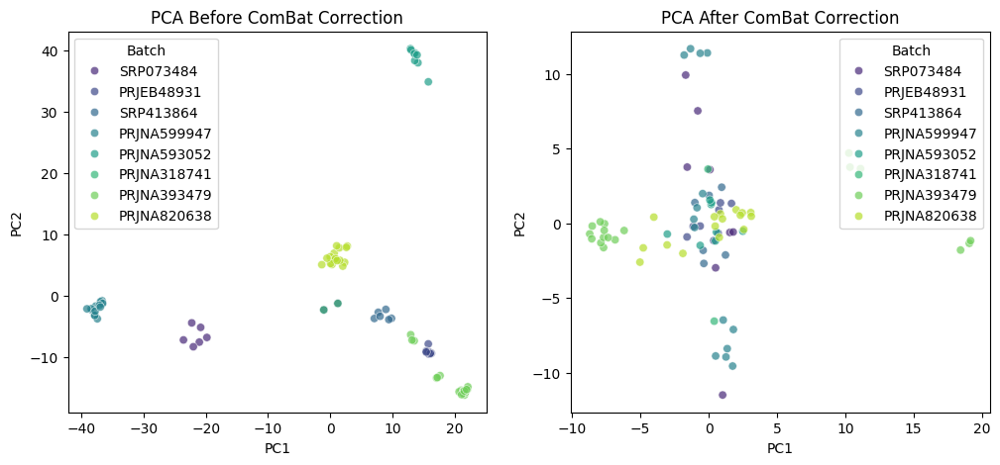

In [63]:
expression_data_values = expression_PCA_df.drop(columns=["Batch"]).to_numpy()

# PCA before correction
pca = PCA(n_components=2)

pca_before = pca.fit_transform(expression_data_values)  # Original data


# PCA after ComBat correction
pca_after = pca.fit_transform(df_corrected)  # Corrected data

# Convert to DataFrame for easy visualization
df_before = pd.DataFrame(pca_before, columns=["PC1", "PC2"])
df_before["Batch"] = sample_names  # Assigning original batch labels

df_after = pd.DataFrame(pca_after, columns=["PC1", "PC2"])
df_after["Batch"] = sample_names  # Assigning original batch labels

# Plot Before
plt.figure(figsize=(12, 5))
plt.subplot(1, 2, 1)
sns.scatterplot(data=df_before, x="PC1", y="PC2", hue="Batch", palette="viridis", alpha=0.7)
plt.title("PCA Before ComBat Correction")

# Plot After
plt.subplot(1, 2, 2)
sns.scatterplot(data=df_after, x="PC1", y="PC2", hue="Batch", palette="viridis", alpha=0.7)
plt.title("PCA After ComBat Correction")

plt.show()

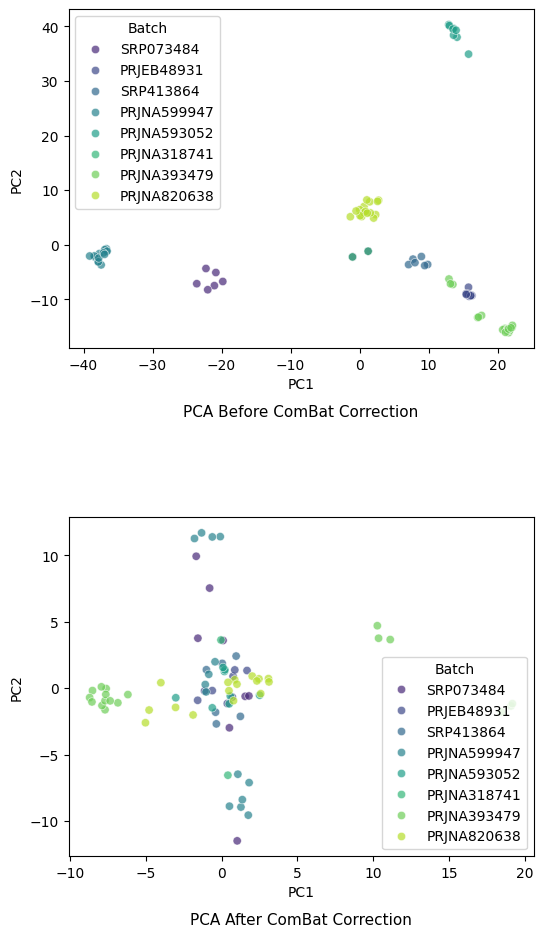

In [64]:
# PCA transformation
pca = PCA(n_components=2)
pca_before = pca.fit_transform(expression_data_values)
pca_after = pca.fit_transform(df_corrected)

df_before = pd.DataFrame(pca_before, columns=["PC1", "PC2"])
df_before["Batch"] = sample_names

df_after = pd.DataFrame(pca_after, columns=["PC1", "PC2"])
df_after["Batch"] = sample_names

fig, axes = plt.subplots(nrows=2, ncols=1, figsize=(6, 11), gridspec_kw={'hspace': 0.5})

# Plot Before
sns.scatterplot(data=df_before, x="PC1", y="PC2", hue="Batch", palette="viridis", alpha=0.7, ax=axes[0])
axes[0].set_xlabel("PC1")
axes[0].set_ylabel("PC2")
axes[0].set_title("")
axes[0].text(0.5, -0.2, "PCA Before ComBat Correction", fontsize=11, ha='center', transform=axes[0].transAxes)

# Plot After
sns.scatterplot(data=df_after, x="PC1", y="PC2", hue="Batch", palette="viridis", alpha=0.7, ax=axes[1])
axes[1].set_xlabel("PC1")
axes[1].set_ylabel("PC2")
axes[1].set_title("")
axes[1].text(0.5, -0.2, "PCA After ComBat Correction", fontsize=11, ha='center', transform=axes[1].transAxes)

plt.tight_layout()
plt.show()

#### Levene's test to check batch effect before and after correction

In [65]:
# Convert batch labels to groups

batch_labels = np.array(sample_names)
unique_batches = np.unique(sample_names)

# Separate data by batches
batch_data_before = [expression_data_values[batch_labels == batch, :].flatten() for batch in unique_batches]
batch_data_after = [combat_data[batch_labels == batch, :].flatten() for batch in unique_batches]

# Levene's test before correction
stat_before, p_before = stats.levene(*batch_data_before)

# Levene's test after correction
stat_after, p_after = stats.levene(*batch_data_after)

print(f"Levene's Test Before Correction: Statistic={stat_before:.4f}, p-value={p_before:.4f}")
print(f"Levene's Test After Correction: Statistic={stat_after:.4f}, p-value={p_after:.4f}")

Levene's Test Before Correction: Statistic=259.4301, p-value=0.0000
Levene's Test After Correction: Statistic=4.1414, p-value=0.0001


#### Mutual Information Classifier to check batch effect before and after correction

In [66]:

# Convert sample names into categorical numeric labels
label_encoder = LabelEncoder()
samples_numeric = label_encoder.fit_transform(sample_names) 
# Compute mutual information between batch labels and each principal component
mi_before = mutual_info_classif(pca_before, samples_numeric)
mi_after = mutual_info_classif(pca_after, samples_numeric)

print("Mutual Information Before Correction:", np.round(mi_before, 4))
print("Mutual Information After Correction:", np.round(mi_after, 4))

Mutual Information Before Correction: [1.5557 1.4537]
Mutual Information After Correction: [0.6689 0.3324]


#### Kruskal Wallis to check batch effect before and after correction

In [67]:

# Convert batch labels to a numpy array
batch_labels = np.array(sample_names)
unique_batches = np.unique(batch_labels)

# Separate data into groups based on batches
batch_data_before = [expression_data_values[batch_labels == batch, :].flatten() for batch in unique_batches]
batch_data_after = [combat_data[batch_labels == batch, :].flatten() for batch in unique_batches]

# Kruskal-Wallis test before correction
stat_before, p_before = stats.kruskal(*batch_data_before)

# Kruskal-Wallis test after correction
stat_after, p_after = stats.kruskal(*batch_data_after)

print(f"Kruskal-Wallis Test Before Correction: Statistic={stat_before:.4f}, p-value={p_before:.4f}")
print(f"Kruskal-Wallis Test After Correction: Statistic={stat_after:.4f}, p-value={p_after:.4f}")

Kruskal-Wallis Test Before Correction: Statistic=120265.3662, p-value=0.0000
Kruskal-Wallis Test After Correction: Statistic=440.4114, p-value=0.0000


# Correlation Analysis

### Spearman Correlation

In [68]:
# Extract PRODUCT-TG values and remove first three rows
batch_correct_expression_df = expression_corrected_df
product_tg_values = batch_correct_expression_df.iloc[-1, :]
#

In [69]:
product_tg_values

ensembl_transcript_id    PRODUCT-TG
sym                      PRODUCT-TG
ensembl_peptide_id       PRODUCT-TG
SRR3401749                  2.34771
SRR3401751                 2.389156
                            ...    
SRR18502225                2.476226
SRR18502226                2.449649
SRR18502229                2.331219
SRR18502230                2.318294
SRR18502233                2.265345
Name: 25593, Length: 83, dtype: object

In [70]:
# Remove the last row (PRODUCT-TG) from the dataset
expression_genes = batch_correct_expression_df.iloc[:-1, :]

In [71]:
# Store gene identifiers separately
gene_metadata = expression_genes[["ensembl_transcript_id","sym", "ensembl_peptide_id"]]


In [72]:
# Remove categorical columns for correlation calculation
expression_genes = expression_genes.drop(columns=["ensembl_transcript_id","sym", "ensembl_peptide_id"])

# Convert all values to numeric
expression_genes = expression_genes.apply(pd.to_numeric, errors='coerce')


In [73]:
# Ensure product_tg_values has the same columns as expression_genes
product_tg_values = product_tg_values.loc[expression_genes.columns]

# Compute Spearman correlation between each gene and PRODUCT-TG
correlation_results = expression_genes.apply(lambda x: stats.spearmanr(x, product_tg_values), axis=1)

# Convert results to DataFrame
correlation_df = pd.DataFrame(correlation_results.tolist(), 
                              index=expression_genes.index, 
                              columns=["Spearman_Correlation", "P_Value"])

# Merge back the gene metadata
correlation_df = gene_metadata.join(correlation_df)

correlation_df.head()

,ensembl_transcript_id,sym,ensembl_peptide_id,Spearman_Correlation,P_Value
0,ENSCGRT00001000002,ENSCGRG00001000002,non-coding,0.184787,0.100811
1,ENSCGRT00001000004,ENSCGRG00001000004,non-coding,0.212963,0.057876
2,ENSCGRT00001000005,ENSCGRG00001000005,non-coding,0.184787,0.100811
3,ENSCGRT00001000006,ND1,ENSCGRP00001000001,0.379817,0.000511
4,ENSCGRT00001000008,ENSCGRG00001000008,non-coding,0.268120,0.016190


In [74]:
# Filter significant correlations (p < 0.05)
significant_correlations = correlation_df[correlation_df["P_Value"] < 0.05]

# Sort by correlation strength
significant_correlations = significant_correlations.sort_values(by="Spearman_Correlation", ascending=False)

significant_correlations.head()

,ensembl_transcript_id,sym,ensembl_peptide_id,Spearman_Correlation,P_Value
13965,ENSCGRT00001019624,ENSCGRG00001015915,ENSCGRP00001015383,0.861158,1.251431e-24
15675,ENSCGRT00001021536,Tmem11,ENSCGRP00001017292,0.839592,2.270545e-22
13736,ENSCGRT00001019364,ENSCGRG00001015816,ENSCGRP00001015125,0.790811,2.649623e-18
15685,ENSCGRT00001021546,Rims2,ENSCGRP00001017302,0.789709,3.179166e-18
8653,ENSCGRT00001013510,Hcrtr1,ENSCGRP00001009311,0.759845,3.037701e-16


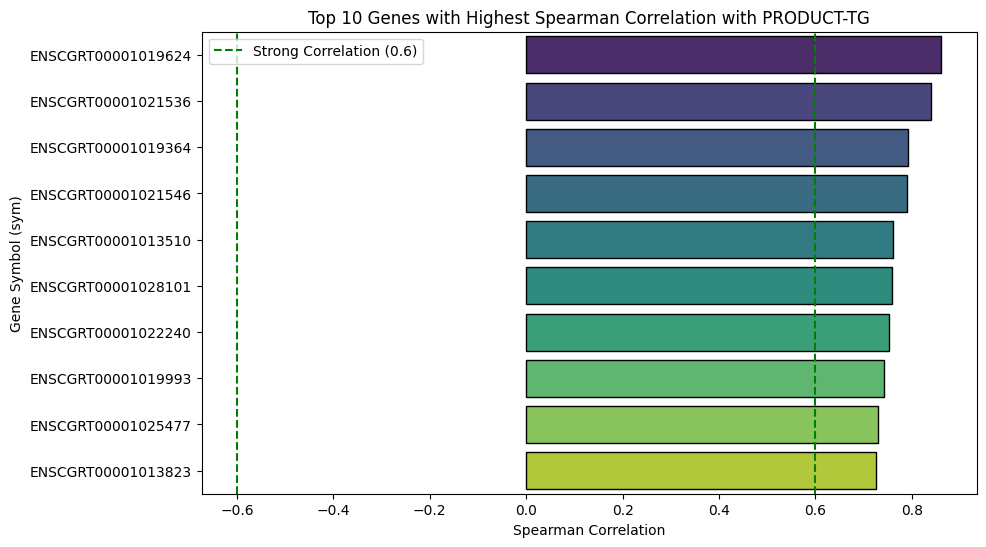

In [75]:

# Select top 10 genes with highest absolute correlation
top_10_genes = significant_correlations.reindex(
    significant_correlations["Spearman_Correlation"].abs().nlargest(10).index
)

# Sort by correlation values
top_10_genes = top_10_genes.sort_values(by="Spearman_Correlation", ascending=False)

# Plot bar chart
plt.figure(figsize=(10,6))
sns.barplot(
    x=top_10_genes["Spearman_Correlation"],
    y=top_10_genes["ensembl_transcript_id"],
    palette="viridis",
    edgecolor="black"
)

plt.axvline(0.6, color='green', linestyle="--", label="Strong Correlation (0.6)")  # Threshold line
plt.axvline(-0.6, color='green', linestyle="--")  # For negative correlation threshold

# Formatting
plt.xlabel("Spearman Correlation")
plt.ylabel("Gene Symbol (sym)")
plt.title("Top 10 Genes with Highest Spearman Correlation with PRODUCT-TG")
plt.legend()

plt.show()

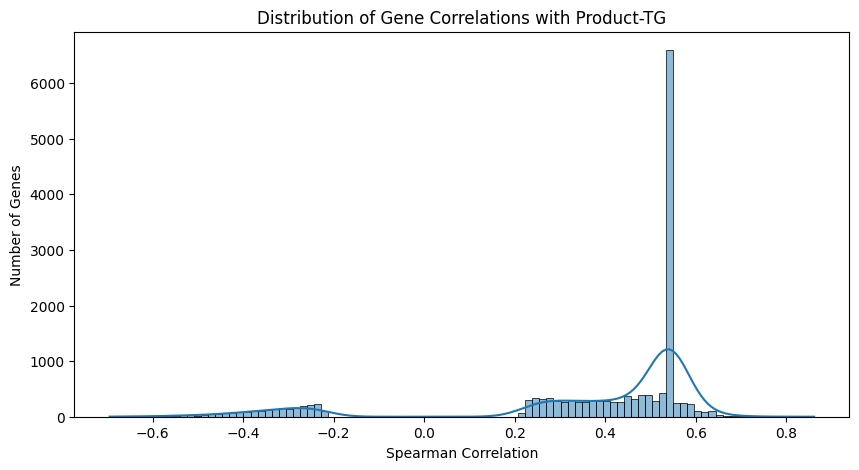

In [76]:
plt.figure(figsize=(10, 5))
sns.histplot(significant_correlations["Spearman_Correlation"], bins=100, kde=True)
plt.xlabel("Spearman Correlation")
plt.ylabel("Number of Genes")
plt.title("Distribution of Gene Correlations with Product-TG")
plt.show()

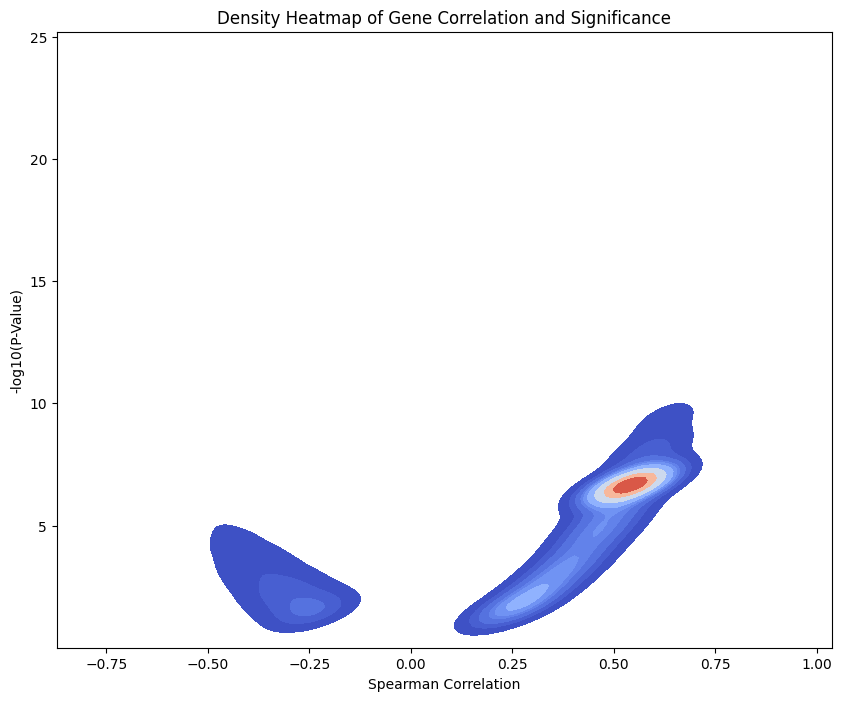

In [77]:
plt.figure(figsize=(10, 8))
sns.kdeplot(
    x=significant_correlations["Spearman_Correlation"], 
    y=-np.log10(significant_correlations["P_Value"]), 
    cmap="coolwarm", fill=True
)
plt.xlabel("Spearman Correlation")
plt.ylabel("-log10(P-Value)")
plt.title("Density Heatmap of Gene Correlation and Significance")
plt.show()

In [78]:
fig = px.scatter(
    correlation_df, 
    x="Spearman_Correlation", 
    y=-np.log10(correlation_df["P_Value"]), 
    hover_data=["ensembl_transcript_id", "sym"],
    title="Interactive Scatter Plot of Gene Correlations",
    labels={"Spearman_Correlation": "Spearman Correlation", "y": "Significance"}
)
fig.show()

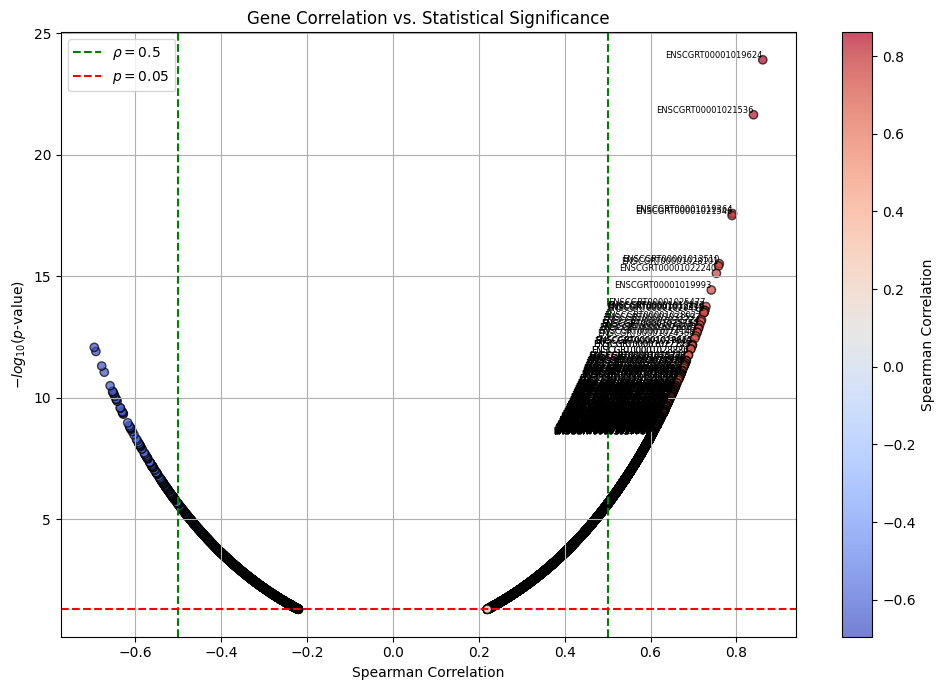

In [79]:
# Compute -log10(P-Value)
significant_correlations["neg_log10_pvalue"] = -np.log10(significant_correlations["P_Value"].replace(0, 1e-300))

plt.figure(figsize=(10, 7))

scatter = plt.scatter(
    significant_correlations["Spearman_Correlation"],
    significant_correlations["neg_log10_pvalue"],
    c=significant_correlations["Spearman_Correlation"],
    cmap="coolwarm",
    edgecolor='k',
    alpha=0.7
)

plt.axvline(0.5, color="green", linestyle="--", label=r"$\rho = 0.5$")
plt.axvline(-0.5, color="green", linestyle="--")
plt.axhline(-np.log10(0.05), color="red", linestyle="--", label=r"$p = 0.05$")

# Label strongest genes
strong_genes = significant_correlations[
    (significant_correlations["Spearman_Correlation"] > 0.6) & 
    (significant_correlations["P_Value"] < 0.01)
]

for _, row in strong_genes.iterrows():
    plt.text(
        row["Spearman_Correlation"],
        row["neg_log10_pvalue"],
        row["ensembl_transcript_id"],  # or if you have gene symbol, use that instead
        fontsize=6,
        ha='right',
        va='bottom'
    )

plt.colorbar(scatter, label="Spearman Correlation")
plt.xlabel("Spearman Correlation")
plt.ylabel(r"$-log_{10}(p\text{-value})$")
plt.title("Gene Correlation vs. Statistical Significance")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

In [80]:
significant_correlations["neg_log10_pvalue"] = -np.log10(significant_correlations["P_Value"].replace(0, 1e-300))

# Create interactive scatter plot
fig = px.scatter(
    significant_correlations,
    x="Spearman_Correlation",
    y="neg_log10_pvalue",
    color="Spearman_Correlation",
    color_continuous_scale="RdBu",
    hover_data=["ensembl_transcript_id", "Spearman_Correlation", "P_Value"],  # Show gene info on hover
    title="Interactive Gene Correlation vs. Statistical Significance",
    labels={
        "Spearman_Correlation": "Spearman Correlation",
        "neg_log10_pvalue": "-log10(P-Value)"
    },
    width=900,
    height=600
)

fig.add_vline(x=0.5, line_dash="dash", line_color="green", annotation_text=r"$\rho = 0.5$", annotation_position="top right")
fig.add_vline(x=-0.5, line_dash="dash", line_color="green", annotation_text=r"$\rho = -0.5$", annotation_position="top left")
fig.add_hline(y=-np.log10(0.05), line_dash="dash", line_color="red", annotation_text=r"$p = 0.05$", annotation_position="bottom right")

fig.update_traces(marker=dict(size=7, line=dict(width=0.5, color='DarkSlateGrey')))
fig.update_layout(coloraxis_colorbar=dict(title="Spearman Correlation"))

fig.show()

**Compute Ranking Score based on Spearman Correlation**

In [81]:
## Compute ranking score
correlation_df["Score"] = correlation_df["Spearman_Correlation"].abs() * -np.log10(correlation_df["P_Value"])

# Filter out genes with low expression variance
expression_genes["Variance"] = expression_genes.var(axis=1)
correlation_df["Variance"] = expression_genes["Variance"]
correlation_df = correlation_df[correlation_df["Variance"] > correlation_df["Variance"].quantile(0.1)]  # Keep top 90% variable genes

# Rank genes based on the score
correlation_df = correlation_df.sort_values(by="Score", ascending=False)


Kendall Correlation was performed when using TPM data, but using raw data removed the need for Kendall and it served as a validaiton instead

### Kendall Correlation

In [82]:
expression_Kendalltau_df = expression_corrected_df

# Count unique values in each row
unique_counts = expression_Kendalltau_df.nunique(axis=1)

# Find genes with many tied values (low unique count)
tied_genes = unique_counts[unique_counts < expression_Kendalltau_df.shape[1] * 0.9]

# Print tied genes
print(f"Number of genes with tied values: {len(tied_genes)}")
print(tied_genes)

Number of genes with tied values: 0
Series([], dtype: int64)


In [83]:

expression_Kendalltau_df = expression_Kendalltau_df.drop(columns=["ensembl_transcript_id","sym", "ensembl_peptide_id"])

# Compute Kendall correlation with PRODUCT-TG
kendall_results = expression_Kendalltau_df.apply(lambda x: kendalltau(x, product_tg_values), axis=1)

# Convert results to DataFrame
kendall_df = pd.DataFrame(kendall_results.tolist(), 
                           index=expression_Kendalltau_df.index, 
                           columns=["Kendall_Correlation", "P_Value"])

print(kendall_df.head())

   Kendall_Correlation   P_Value
0             0.138608  0.068798
1             0.174051  0.022309
2             0.138608  0.068798
3             0.303165  0.000069
4             0.187975  0.013592


In [84]:
kendall_Final_df = gene_metadata.join(kendall_df)

In [85]:
# Filter significant correlations (p < 0.05)
significant_kendall = kendall_Final_df[kendall_Final_df["P_Value"] < 0.05]

# Sort by correlation strength
significant_kendall = significant_kendall.sort_values(by="Kendall_Correlation", ascending=False)

significant_kendall

,ensembl_transcript_id,sym,ensembl_peptide_id,Kendall_Correlation,P_Value
13965,ENSCGRT00001019624,ENSCGRG00001015915,ENSCGRP00001015383,0.677848,5.620663e-19
15675,ENSCGRT00001021536,Tmem11,ENSCGRP00001017292,0.641772,3.587366e-17
15685,ENSCGRT00001021546,Rims2,ENSCGRP00001017302,0.617722,5.066101e-16
13736,ENSCGRT00001019364,ENSCGRG00001015816,ENSCGRP00001015125,0.575316,4.247695e-14
16305,ENSCGRT00001022240,Stk24,ENSCGRP00001017996,0.565190,1.169197e-13
...,...,...,...,...,...
8995,ENSCGRT00001013927,Zfp451,ENSCGRP00001009708,-0.484810,1.953625e-10
18804,ENSCGRT00001025013,Ttc33,ENSCGRP00001020769,-0.487975,1.489084e-10
20734,ENSCGRT00001027195,Rab3gap1,ENSCGRP00001022950,-0.489873,1.264195e-10
18735,ENSCGRT00001024931,Il15ra,ENSCGRP00001020687,-0.492405,1.015304e-10


In [86]:
top_n = 10
kendall_Graph_df = significant_kendall.head(top_n)

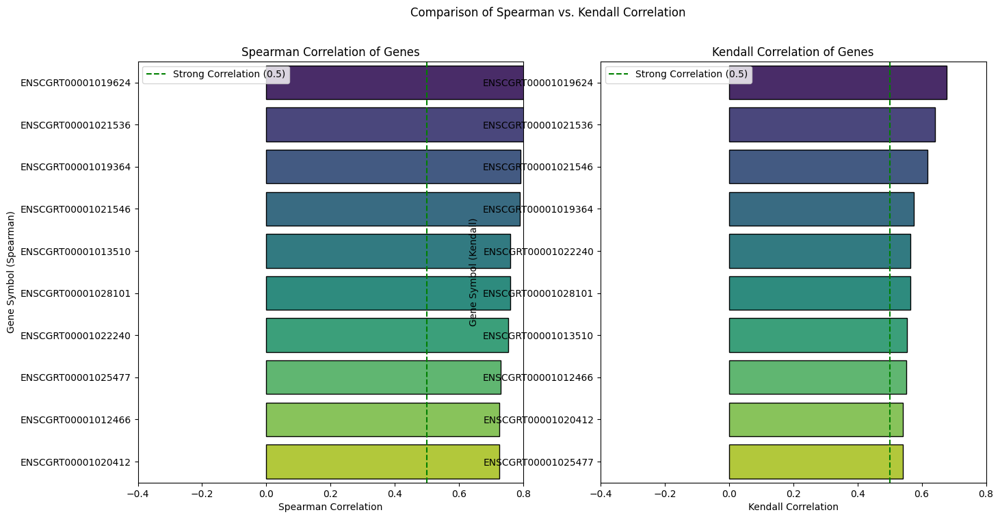

In [87]:
# Merge Spearman and Kendall correlation datasets
comparison_df = kendall_Graph_df.merge(significant_correlations, on="ensembl_transcript_id", suffixes=("_Kendall", "_Spearman"))

top_genes_spearman = comparison_df.reindex(comparison_df["Spearman_Correlation"].abs().nlargest(10).index)
top_genes_kendall = comparison_df.reindex(comparison_df["Kendall_Correlation"].abs().nlargest(10).index)

top_genes_spearman = top_genes_spearman.sort_values(by="Spearman_Correlation", ascending=False)
top_genes_kendall = top_genes_kendall.sort_values(by="Kendall_Correlation", ascending=False)

# Create subplots for Spearman vs. Kendall (sharey=False for separate labels)
fig, axes = plt.subplots(1, 2, figsize=(16, 8), sharey=False)

# Plot Spearman Correlation as a horizontal bar chart
sns.barplot(
    x="Spearman_Correlation", 
    y="ensembl_transcript_id", 
    data=top_genes_spearman, 
    palette="viridis", 
    edgecolor="black", 
    ax=axes[0],
    ci=None
)
axes[0].axvline(0.5, color='green', linestyle="--", label="Strong Correlation (0.5)")
axes[0].axvline(-0.5, color='green', linestyle="--")
axes[0].set_xlim(-0.4, 0.8)  # Ensuring same scale
axes[0].set_title("Spearman Correlation of Genes")
axes[0].set_xlabel("Spearman Correlation")
axes[0].set_ylabel("Gene Symbol (Spearman)")  # Separate gene labels

# Plot Kendall Correlation as a horizontal bar chart
sns.barplot(
    x="Kendall_Correlation", 
    y="ensembl_transcript_id", 
    data=top_genes_kendall, 
    palette="viridis", 
    edgecolor="black", 
    ax=axes[1]
)
axes[1].axvline(0.5, color='green', linestyle="--", label="Strong Correlation (0.5)")
axes[1].axvline(-0.5, color='green', linestyle="--")
axes[1].set_xlim(-0.4, 0.8)  # Ensuring same scale
axes[1].set_title("Kendall Correlation of Genes")
axes[1].set_xlabel("Kendall Correlation")
axes[1].set_ylabel("Gene Symbol (Kendall)")  # Separate gene labels

# Add a shared title
plt.suptitle("Comparison of Spearman vs. Kendall Correlation")

# Show legends for both plots separately
axes[0].legend()
axes[1].legend()

plt.show()

**Random Forest Feature Importance**

In [88]:
expression_RandomForest_df = expression_corrected_df
gene_metadata_RandomForest = expression_RandomForest_df[["ensembl_transcript_id", "sym", "ensembl_peptide_id"]]
expression_RandomForest_df = expression_RandomForest_df.drop(columns=["ensembl_transcript_id", "sym", "ensembl_peptide_id"])

X = expression_RandomForest_df.T
y = expression_RandomForest_df.iloc[-1, :]

# Remove PRODUCT-TG row from features
X = X.iloc[:-1, :]

# Align indices to ensure no mismatches
X, y = X.align(y, join="inner", axis=0)

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

rf = RandomForestRegressor(n_estimators=100, random_state=42)
rf.fit(X_train, y_train)

feature_importance = rf.feature_importances_

importance_df = pd.DataFrame({'Gene': X.columns, 'Importance': feature_importance})
importance_df = importance_df.sort_values(by="Importance", ascending=False)

In [89]:
importance_df = gene_metadata.join(importance_df)

**Feature Importance of Genes Plot**

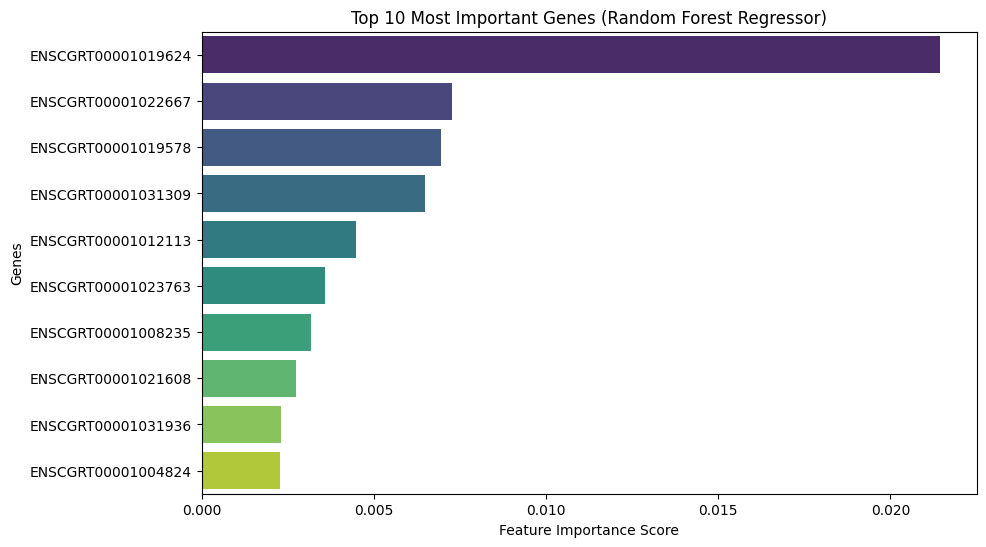

In [90]:
# Remove genes with zero importance
importance_df = importance_df[importance_df["Importance"] > 0]

# Sort before selecting top genes
importance_df = importance_df.sort_values(by="Importance", ascending=False).reset_index(drop=True)

top_n = 10
importance_graph_df = importance_df.head(top_n)

plt.figure(figsize=(10, 6))  
sns.barplot(x="Importance", y="ensembl_transcript_id", data=importance_graph_df, palette="viridis")

plt.xlabel("Feature Importance Score")
plt.ylabel("Genes")
plt.title(f"Top {top_n} Most Important Genes (Random Forest Regressor)")
plt.show()

**Ranking by calculating a score using  formula**

In [91]:
# Merge Spearman correlation and Random Forest results on 'ensembl_transcript_id'
ranked_df = pd.merge(correlation_df, importance_df, on=["ensembl_transcript_id", "sym", "ensembl_peptide_id"], how="inner")

# Apply -log10 transformation to Spearman P-values for better ranking
ranked_df["P_Value_Corrected"] = -np.log10(ranked_df["P_Value"].replace(0, 1e-300))  # Prevent log(0) errors

# Normalize all ranking metrics (scale between 0–1)
scaler = MinMaxScaler()
ranked_df[["Importance", "Spearman_Correlation", "P_Value_Corrected"]] = scaler.fit_transform(
    ranked_df[["Importance", "Spearman_Correlation", "P_Value_Corrected"]]
)

# Compute Final Score using weighted sum
ranked_df["Final_Score"] = (
    (ranked_df["Importance"] * 0.40) +               # Feature importance from Random Forest
    (ranked_df["Spearman_Correlation"] * 0.30) +     # Spearman correlation with expression variability
    (ranked_df["P_Value_Corrected"] * 0.10)          # Higher score for more significant correlation
)

# 🔹 Sort genes by final ranking score
ranked_df = ranked_df.sort_values(by="Final_Score", ascending=False).reset_index(drop=True)

**Ranking plot as per calculated score**

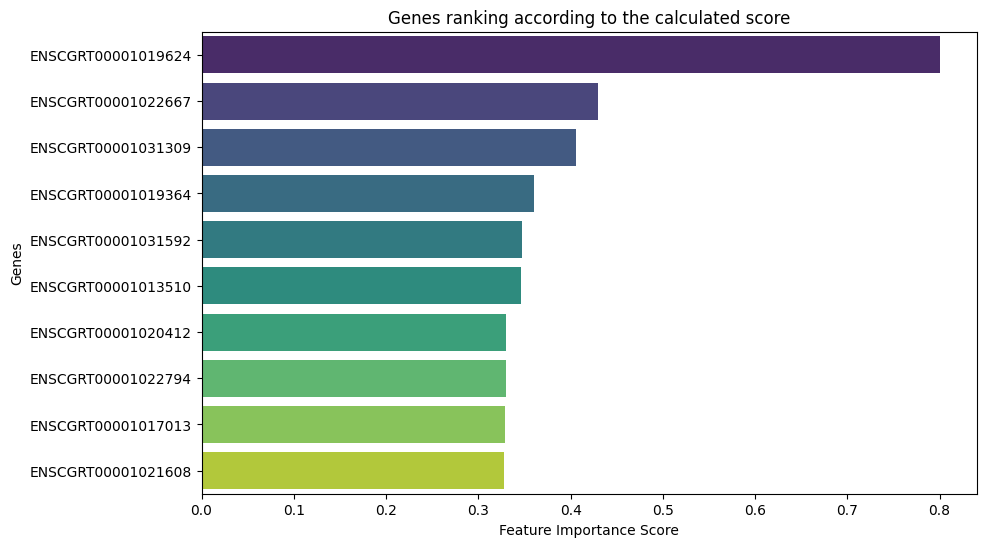

In [92]:
top_n = 10
ranked_graph_df = ranked_df.head(top_n)

plt.figure(figsize=(10, 6))  # Adjust height for large datasets
sns.barplot(x="Final_Score", y="ensembl_transcript_id", data=ranked_graph_df, palette="viridis")

plt.xlabel("Feature Importance Score")
plt.ylabel("Genes")
plt.title("Genes ranking according to the calculated score")
plt.show()

### ANOVA Analysis

In [93]:
expression_Classification_df = expression_corrected_df

In [94]:
target_gene = "PRODUCT-TG"

In [95]:
target_gene_values = expression_Classification_df[expression_Classification_df["ensembl_transcript_id"] == target_gene].iloc[:, 3:].values.flatten()

In [96]:
target_gene_values

array([2.34770962, 2.38915567, 2.23200418, 2.38067861, 2.37302425,
       2.63494681, 2.42171791, 2.58191295, 2.3710211 , 2.37714186,
       2.26319011, 2.39861158, 2.36875852, 2.34551747, 2.49619108,
       2.42927666, 2.52457086, 2.51688639, 2.24215646, 2.51239848,
       2.2391972 , 2.25183958, 2.49444114, 2.43285074, 2.39076798,
       2.26085263, 2.29636122, 2.36193871, 2.49148523, 2.35674888,
       2.21589294, 2.48810027, 2.42812139, 2.17658558, 2.47478069,
       2.47069399, 2.32657509, 2.32536451, 2.29317928, 2.46457058,
       2.39781897, 2.26177948, 2.40190339, 2.5174012 , 2.29183658,
       2.51586992, 2.46506061, 2.42678237, 2.46112576, 2.30004571,
       2.33320275, 2.14986038, 2.45789305, 2.44760485, 2.46820006,
       2.47001391, 2.42073366, 2.47208375, 2.47309981, 2.31447217,
       2.44928181, 2.14136723, 2.13928189, 2.46444956, 2.47494362,
       2.32986024, 2.26784408, 2.33551596, 2.38470645, 2.33442852,
       2.2487366 , 2.28756439, 2.65287656, 2.29612462, 2.49552

In [97]:
productTG_classification = pd.cut(product_tg_values, bins=4, labels=["Low", "Mid-Low", "Mid-High", "High"])

In [98]:
classification_df = pd.DataFrame({
    "Sample": expression_Classification_df.columns[3:],  # Sample names (column headers after gene info)
    "Expression_Value": target_gene_values,
    "Classification": productTG_classification
})

In [99]:
# # Merge classification labels back to the original dataset
df_expression_classified = expression_Classification_df.copy()
df_expression_classified = df_expression_classified.iloc[:, 3:].T 
df_expression_classified.columns = expression_Classification_df["ensembl_transcript_id"]
df_expression_classified["Classification"] = classification_df["Classification"].values

In [100]:
classification_df = classification_df.set_index("Sample") 
df_expression_classified = df_expression_classified.loc[classification_df.index]
df_expression_classified["Classification"] = classification_df["Classification"]

In [101]:
anova_results = []
for gene in df_expression_classified.columns[:-1]:
    gene_values = df_expression_classified[gene]
    
    # Perform ANOVA across the four categories
    groups = [gene_values[df_expression_classified["Classification"] == cat] for cat in ["Low", "Mid-Low", "Mid-High", "High"]]
    f_stat, p_value = stats.f_oneway(*groups)
    
    anova_results.append((gene, f_stat, p_value))

In [102]:
anova_result_df = pd.DataFrame(anova_results, columns=["Gene", "F-Statistic", "P-Value"])

In [103]:
anova_result_df

,Gene,F-Statistic,P-Value
0,ENSCGRT00001000002,0.768008,5.154766e-01
1,ENSCGRT00001000004,1.288755,2.843856e-01
2,ENSCGRT00001000005,0.768008,5.154766e-01
3,ENSCGRT00001000006,9.018199,3.510922e-05
4,ENSCGRT00001000008,0.242678,8.662903e-01
...,...,...,...
25589,ENSCGRT00001032572,2.790714,4.613976e-02
25590,ENSCGRT00001032573,0.197819,8.975718e-01
25591,ENSCGRT00001032574,7.759586,1.377812e-04
25592,ENSCGRT00001032575,0.532831,6.611491e-01


### Classification-Based Random Forest

In [104]:
df_expression_classified["Classification"].value_counts(normalize=True) 

Classification
Mid-High    0.425
Mid-Low     0.350
Low         0.175
High        0.050
Name: proportion, dtype: float64

In [105]:
label_encoder = LabelEncoder()
df_expression_classified["Classification_Encoded"] = label_encoder.fit_transform(df_expression_classified["Classification"])

In [106]:
X = df_expression_classified.drop(columns=["PRODUCT-TG","Classification", "Classification_Encoded"])
y = df_expression_classified["Classification_Encoded"]

In [107]:
rf = RandomForestClassifier(n_estimators=100, random_state=42, class_weight = 'balanced')
rf.fit(X, y)

RandomForestClassifier(class_weight='balanced', random_state=42)

In [108]:
feature_importances = pd.DataFrame({
    "Gene": X.columns,
    "Importance": rf.feature_importances_
}).sort_values(by="Importance", ascending=False)

In [109]:
feature_importances

,Gene,Importance
13965,ENSCGRT00001019624,0.008182
995,ENSCGRT00001001128,0.007054
14852,ENSCGRT00001020626,0.006477
15603,ENSCGRT00001021457,0.006343
20240,ENSCGRT00001026648,0.005965
...,...,...
8661,ENSCGRT00001013520,0.000000
8660,ENSCGRT00001013519,0.000000
8659,ENSCGRT00001013517,0.000000
8658,ENSCGRT00001013515,0.000000


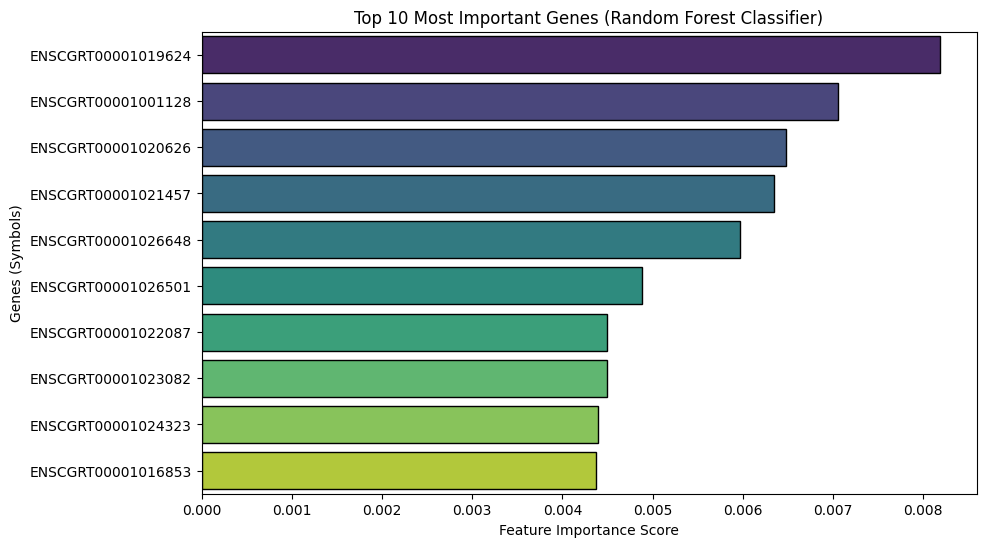

In [110]:
top_n = 10
top_features = feature_importances.head(top_n)

plt.figure(figsize=(10, 6))
sns.barplot(x="Importance", y="Gene", data=top_features, palette="viridis", edgecolor="black")

# Formatting
plt.xlabel("Feature Importance Score")
plt.ylabel("Genes (Symbols)")
plt.title(f"Top {top_n} Most Important Genes (Random Forest Classifier)")
plt.show()

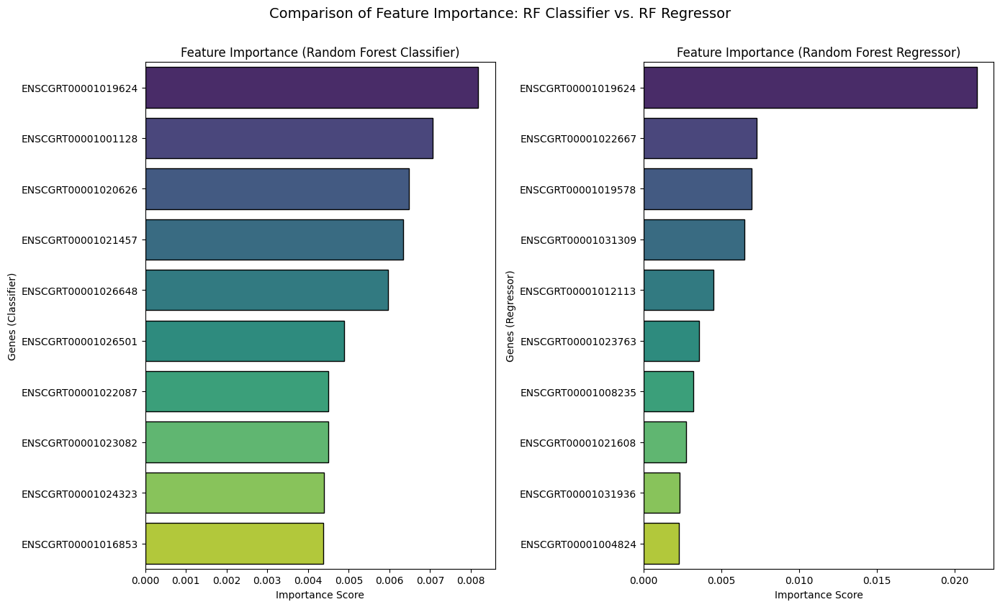

In [111]:
top_n = 10 
rf_classifier_top = feature_importances.sort_values(by="Importance", ascending=False).head(top_n)
rf_regressor_top = importance_graph_df.sort_values(by="Importance", ascending=False).head(top_n)

fig, axes = plt.subplots(1, 2, figsize=(14, 8), sharey=False)  # Increased height

sns.barplot(
    x="Importance", y="Gene", data=rf_classifier_top,
    palette="viridis", edgecolor="black", ax=axes[0]
)
axes[0].set_title("Feature Importance (Random Forest Classifier)")
axes[0].set_xlabel("Importance Score")
axes[0].set_ylabel("Genes (Classifier)")
axes[0].tick_params(axis='y', labelsize=10)


for label in axes[0].get_yticklabels():
    label.set_rotation(0)  # Keep labels horizontal but space them properly
    label.set_ha("right")  # Align text to the right

sns.barplot(
    x="Importance", y="ensembl_transcript_id", data=rf_regressor_top,
    palette="viridis", edgecolor="black", ax=axes[1]
)
axes[1].set_title("Feature Importance (Random Forest Regressor)")
axes[1].set_xlabel("Importance Score")
axes[1].set_ylabel("Genes (Regressor)")

plt.tight_layout()

plt.suptitle("Comparison of Feature Importance: RF Classifier vs. RF Regressor", fontsize=14, y=1.05)

plt.show()

## Composite Gene Ranking

In [112]:
#Merge all three dataframes
feature_importances_classifier = feature_importances.rename(columns={"Gene": "ensembl_transcript_id", "Importance": "Classifier_Importance"})

#Merge regressor + spearman
merged_df = pd.merge(correlation_df, importance_df, on=["ensembl_transcript_id", "sym", "ensembl_peptide_id"], how="inner")

#Merge classifier
merged_df = pd.merge(merged_df, feature_importances_classifier, on="ensembl_transcript_id", how="inner")

#Transform P-values
merged_df["P_Value_Corrected"] = -np.log10(merged_df["P_Value"].replace(0, 1e-300))  # Avoid log(0)

#Normalize all components
scaler = MinMaxScaler()
merged_df[["Importance", "Spearman_Correlation", "P_Value_Corrected", "Classifier_Importance"]] = scaler.fit_transform(
    merged_df[["Importance", "Spearman_Correlation", "P_Value_Corrected", "Classifier_Importance"]]
)

#Compute Final Composite Score
merged_df["Final_Composite_Score"] = (
    (merged_df["Importance"] * 0.35) +              # RF Regressor
    (merged_df["Spearman_Correlation"] * 0.30) +    # Spearman correlation
    (merged_df["P_Value_Corrected"] * 0.10) +       # Statistical strength
    (merged_df["Classifier_Importance"] * 0.25)     # RF Classifier
)

#Sort the final ranking
ranking_4 = merged_df.sort_values(by="Final_Composite_Score", ascending=False).reset_index(drop=True)

In [113]:
#Ranking 1: Regressor Only
ranking_1 = importance_df.sort_values(by="Importance", ascending=False).reset_index(drop=True)
ranking_1.to_csv("ranking_1_regressor_importance.csv", index=False)

#Ranking 2: Composite of Regressor + Spearman
# Make sure 'Score' was already computed as: abs(Spearman_Correlation) * -log10(P_Value)
ranking_2 = correlation_df.sort_values(by="Score", ascending=False).reset_index(drop=True)
ranking_2.to_csv("ranking_2_spearman_regressor_composite.csv", index=False)

#Ranking 3: Classifier Only
ranking_3 = feature_importances.rename(columns={"Gene": "ensembl_transcript_id", "Importance": "Classifier_Importance"})
ranking_3 = ranking_3[ranking_3["Classifier_Importance"] > 0]  #removed zero-importance genes
ranking_3 = ranking_3.sort_values(by="Classifier_Importance", ascending=False).reset_index(drop=True)
ranking_3.to_csv("ranking_3_classifier_importance.csv", index=False)

#Ranking 4: Full Composite (Regressor + Spearman + Classifier)
ranking_4.to_csv("ranking_4_final_composite.csv", index=False)

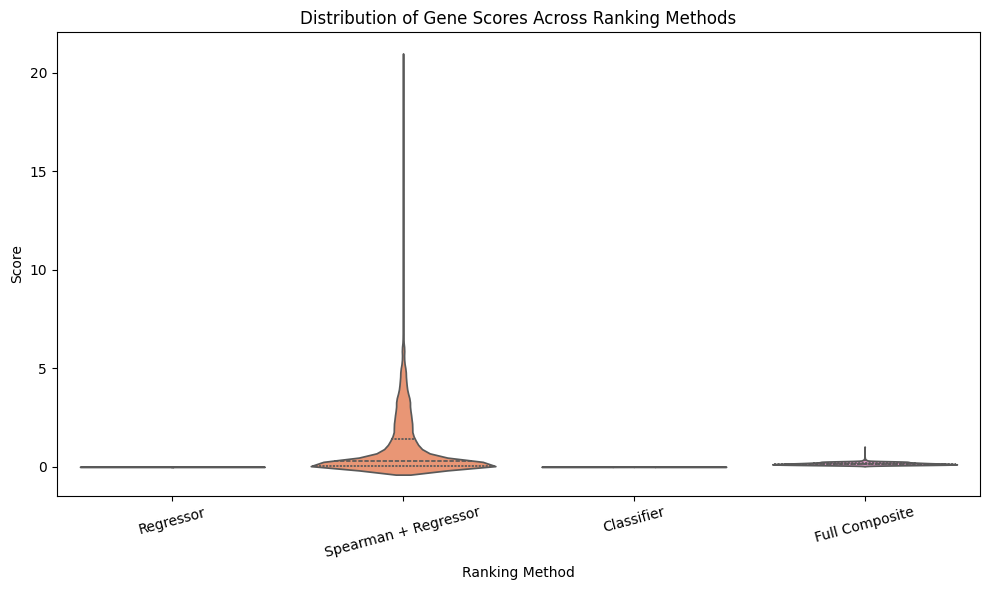

In [114]:
# Load the ranking files
ranking_1 = pd.read_csv("ranking_1_regressor_importance.csv")
ranking_2 = pd.read_csv("ranking_2_spearman_regressor_composite.csv")
ranking_3 = pd.read_csv("ranking_3_classifier_importance.csv")
ranking_4 = pd.read_csv("ranking_4_final_composite.csv")

#Unified DataFrame for plotting
ranking_scores_df = pd.DataFrame({
    "Regressor": ranking_1["Importance"],
    "Spearman + Regressor": ranking_2["Score"],
    "Classifier": ranking_3["Classifier_Importance"],
    "Full Composite": ranking_4["Final_Composite_Score"]
})

#Melt to long format
ranking_scores_long = ranking_scores_df.melt(var_name="Ranking Method", value_name="Score")

plt.figure(figsize=(10, 6))
sns.violinplot(x="Ranking Method", y="Score", data=ranking_scores_long, inner="quartile", palette="Set2")
plt.title("Distribution of Gene Scores Across Ranking Methods")
plt.ylabel("Score")
plt.xticks(rotation=15)
plt.tight_layout()

plt.savefig("ranking_score_distribution.png", dpi=300)
plt.show()

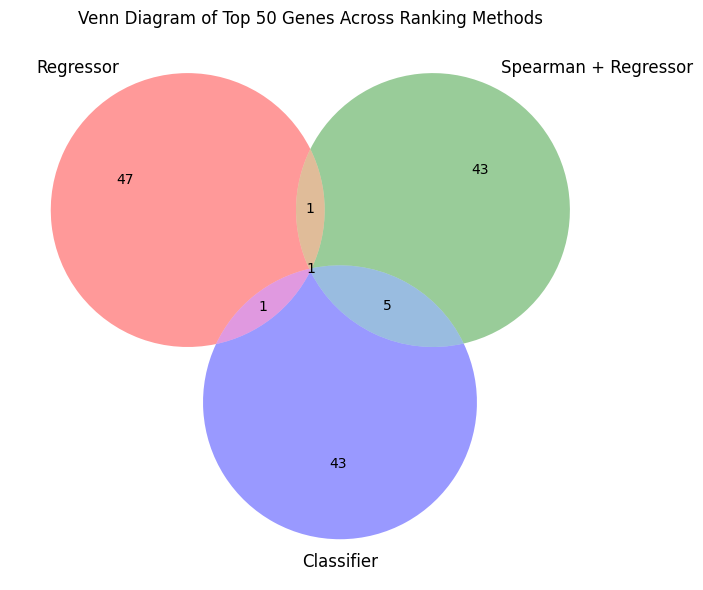

In [115]:
# Load ranking files
ranking_1 = pd.read_csv("ranking_1_regressor_importance.csv")
ranking_2 = pd.read_csv("ranking_2_spearman_regressor_composite.csv")
ranking_3 = pd.read_csv("ranking_3_classifier_importance.csv")
ranking_4 = pd.read_csv("ranking_4_final_composite.csv")

# Extract top 50 genes from each ranking
top50_regressor = set(ranking_1.sort_values(by="Importance", ascending=False).head(50)["ensembl_transcript_id"])
top50_spearman = set(ranking_2.sort_values(by="Score", ascending=False).head(50)["ensembl_transcript_id"])
top50_classifier = set(ranking_3.sort_values(by="Classifier_Importance", ascending=False).head(50)["ensembl_transcript_id"])
top50_composite = set(ranking_4.sort_values(by="Final_Composite_Score", ascending=False).head(50)["ensembl_transcript_id"])

#Venn Diagram
plt.figure(figsize=(8, 6))
venn = venn3(
    [top50_regressor, top50_spearman, top50_classifier],
    set_labels=("Regressor", "Spearman + Regressor", "Classifier")
)

plt.title("Venn Diagram of Top 50 Genes Across Ranking Methods")
plt.tight_layout()
plt.savefig("top50_venn_diagram.png", dpi=300)
plt.show()

<Figure size 1000x600 with 0 Axes>

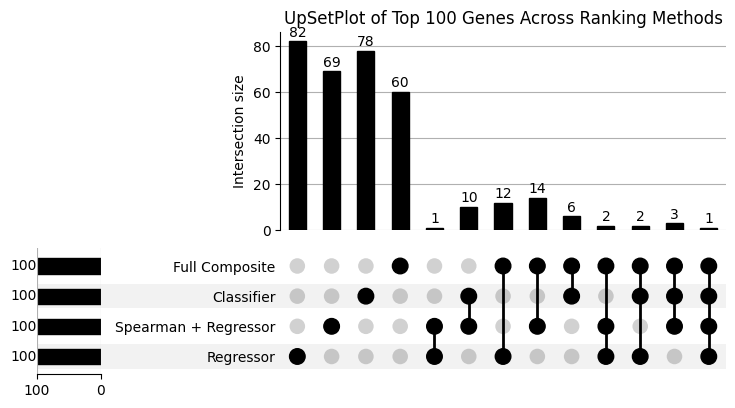

In [116]:
# Load the ranking files
ranking_1 = pd.read_csv("ranking_1_regressor_importance.csv")
ranking_2 = pd.read_csv("ranking_2_spearman_regressor_composite.csv")
ranking_3 = pd.read_csv("ranking_3_classifier_importance.csv")
ranking_4 = pd.read_csv("ranking_4_final_composite.csv")

# Extract top 50 genes from each ranking
top100_regressor = set(ranking_1.sort_values(by="Importance", ascending=False).head(100)["ensembl_transcript_id"])
top100_spearman = set(ranking_2.sort_values(by="Score", ascending=False).head(100)["ensembl_transcript_id"])
top100_classifier = set(ranking_3.sort_values(by="Classifier_Importance", ascending=False).head(100)["ensembl_transcript_id"])
top100_composite = set(ranking_4.sort_values(by="Final_Composite_Score", ascending=False).head(100)["ensembl_transcript_id"])

# Create a DataFrame indicating gene membership across sets
all_genes = top100_regressor.union(top100_spearman).union(top100_classifier).union(top100_composite)
gene_membership = pd.DataFrame(index=list(all_genes))
gene_membership['Regressor'] = gene_membership.index.isin(top100_regressor)
gene_membership['Spearman + Regressor'] = gene_membership.index.isin(top100_spearman)
gene_membership['Classifier'] = gene_membership.index.isin(top100_classifier)
gene_membership['Full Composite'] = gene_membership.index.isin(top100_composite)

gene_membership_fixed = gene_membership.set_index(['Regressor', 'Spearman + Regressor', 'Classifier', 'Full Composite'])

# Plot UpSetPlot
plt.figure(figsize=(10, 6))
upset = UpSet(gene_membership_fixed, subset_size='count', show_counts=True)
upset.plot()
plt.title("UpSetPlot of Top 100 Genes Across Ranking Methods")
plt.savefig("top50_upsetplot.png", dpi=300)
plt.show()

In [117]:
overlap_all_four = top100_regressor & top100_spearman & top100_classifier & top100_composite
overlap_regressor_spearman = top100_regressor & top100_spearman
overlap_regressor_classifier = top100_regressor & top100_classifier
overlap_classifier_composite = top100_classifier & top100_composite

print(f"Genes in ALL four top-100 lists: {len(overlap_all_four)}")
print(overlap_all_four)  # List actual gene IDs

Genes in ALL four top-100 lists: 1
{'ENSCGRT00001019624'}


In [118]:
# Create master gene list
all_genes = list(top100_regressor.union(top100_spearman).union(top100_classifier).union(top100_composite))

# Build the overlap table
overlap_df = pd.DataFrame({
    "ensembl_transcript_id": all_genes,
    "In Regressor": [gene in top100_regressor for gene in all_genes],
    "In Spearman+Regressor": [gene in top100_spearman for gene in all_genes],
    "In Classifier": [gene in top100_classifier for gene in all_genes],
    "In Composite": [gene in top100_composite for gene in all_genes]
})

# Add a "Total Hits" column
overlap_df["Total Hits"] = overlap_df[["In Regressor", "In Spearman+Regressor", "In Classifier", "In Composite"]].sum(axis=1)

# Sort by Total Hits descending
overlap_df = overlap_df.sort_values(by="Total Hits", ascending=False).reset_index(drop=True)

# Save to CSV
overlap_df.to_csv("top50_gene_overlap_summary.csv", index=False)

overlap_df.head(10)

,ensembl_transcript_id,In Regressor,In Spearman+Regressor,In Classifier,In Composite,Total Hits
0,ENSCGRT00001019624,True,True,True,True,4
1,ENSCGRT00001023166,False,True,True,True,3
2,ENSCGRT00001017013,True,True,False,True,3
3,ENSCGRT00001005223,True,False,True,True,3
4,ENSCGRT00001031592,True,True,False,True,3
5,ENSCGRT00001029665,False,True,True,True,3
6,ENSCGRT00001022794,False,True,True,True,3
7,ENSCGRT00001024323,True,False,True,True,3
8,ENSCGRT00001027245,False,True,False,True,2
9,ENSCGRT00001027967,False,True,True,False,2


# TASK 2

### Filter genes based on Coefficient of Variance

In [119]:
constantly_expressed_df = expression_corrected_df


gene_col = "ensembl_transcript_id"
sample_cols = constantly_expressed_df.columns[3:]

constantly_expressed_df["mean_expression"] = constantly_expressed_df[sample_cols].mean(axis=1)
constantly_expressed_df["variance"] = constantly_expressed_df[sample_cols].var(axis=1)
constantly_expressed_df["CV"] = constantly_expressed_df["variance"] / constantly_expressed_df["mean_expression"]
constantly_expressed_df["MAD"] = constantly_expressed_df[sample_cols].apply(median_abs_deviation, axis=1)

constitutive_genes = constantly_expressed_df.sort_values(by=["variance", "mean_expression"], ascending=[True, False])

In [120]:
UTR5_GC_Content_df = UTR5_sequences_df

In [121]:
UTR5_GC_Content_df = UTR5_GC_Content_df[UTR5_GC_Content_df["Sequence"] != "Sequenceunavailable"]

In [122]:
def calculate_gc_content(sequence):
    if isinstance(sequence, str):
        gc_count = sequence.count('G') + sequence.count('C')
        return (gc_count / len(sequence)) * 100 if len(sequence) > 0 else 0
    return None

UTR5_GC_Content_df["GC_Content (%)"] = UTR5_GC_Content_df["Sequence"].apply(calculate_gc_content)

In [123]:
UTR5_GC_Content_df_sorted = UTR5_GC_Content_df.sort_values(by="GC_Content (%)", ascending=False)

In [124]:
avg_gc_5utr = UTR5_GC_Content_df["GC_Content (%)"].mean()
print(f"Average GC Content for 5'UTR: {avg_gc_5utr:.2f}%")

Average GC Content for 5'UTR: 63.56%


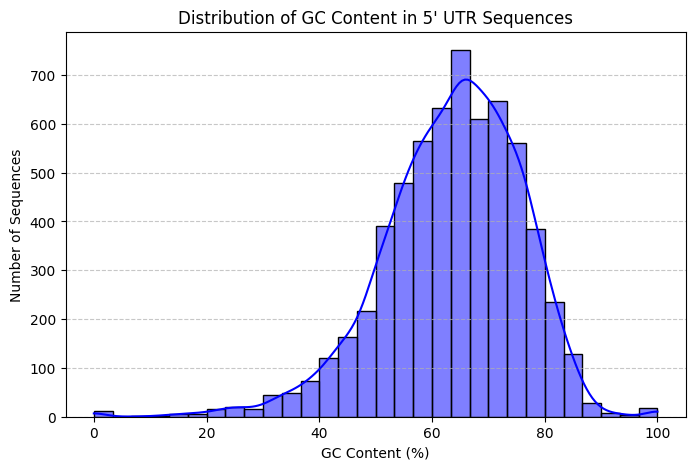

In [125]:
plt.figure(figsize=(8, 5))
sns.histplot(UTR5_GC_Content_df_sorted["GC_Content (%)"], bins=30, kde=True, color="blue")

plt.xlabel("GC Content (%)")
plt.ylabel("Number of Sequences")
plt.title("Distribution of GC Content in 5' UTR Sequences")
plt.grid(axis='y', linestyle='--', alpha=0.7)

plt.show()

In [126]:
UTR3_GC_Content_df = UTR3_sequences_df

In [127]:
UTR3_GC_Content_df = UTR3_GC_Content_df[UTR3_GC_Content_df["Sequence"] != "Sequenceunavailable"]

In [128]:
UTR3_GC_Content_df["GC_Content (%)"] = UTR3_GC_Content_df["Sequence"].apply(calculate_gc_content)

In [129]:
UTR3_GC_Content_df_sorted = UTR3_GC_Content_df.sort_values(by="GC_Content (%)", ascending=False)

In [130]:
avg_gc_3utr = UTR3_GC_Content_df["GC_Content (%)"].mean()
print(f"Average GC Content for 3'UTR: {avg_gc_3utr:.2f}%")

Average GC Content for 3'UTR: 44.29%


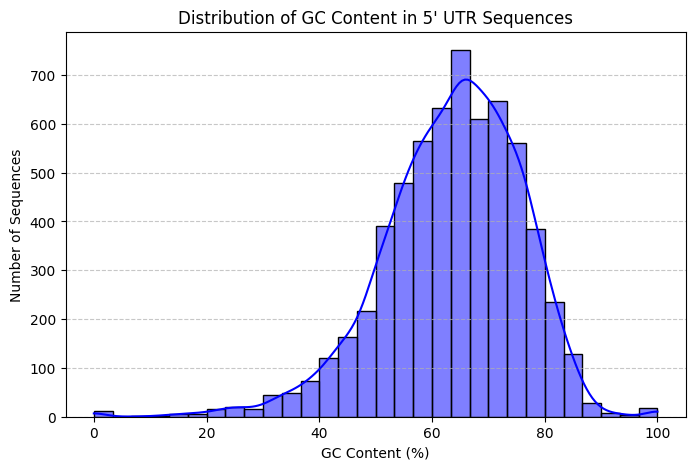

In [131]:
plt.figure(figsize=(8, 5))
sns.histplot(UTR5_GC_Content_df_sorted["GC_Content (%)"], bins=30, kde=True, color="blue")

plt.xlabel("GC Content (%)")
plt.ylabel("Number of Sequences")
plt.title("Distribution of GC Content in 5' UTR Sequences")
plt.grid(axis='y', linestyle='--', alpha=0.7)

plt.show()

In [132]:
CDS_GC_Content_df = CDS_sequences_df

In [133]:
CDS_GC_Content_df = CDS_GC_Content_df[CDS_GC_Content_df["Sequence"] != "Sequenceunavailable"]

In [134]:
CDS_GC_Content_df["GC_Content (%)"] = CDS_GC_Content_df["Sequence"].apply(calculate_gc_content)

In [135]:
CDS_GC_Content_df_sorted = CDS_GC_Content_df.sort_values(by="GC_Content (%)", ascending=False)

In [136]:
avg_gc_cds = CDS_GC_Content_df["GC_Content (%)"].mean()
print(f"Average GC Content for CDS: {avg_gc_cds:.2f}%")

Average GC Content for CDS: 51.69%


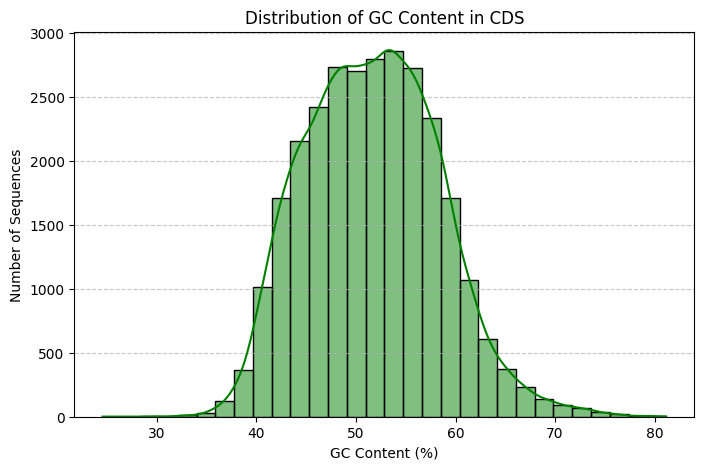

In [137]:
plt.figure(figsize=(8, 5))
sns.histplot(CDS_GC_Content_df_sorted["GC_Content (%)"], bins=30, kde=True, color="green")

# Formatting
plt.xlabel("GC Content (%)")
plt.ylabel("Number of Sequences")
plt.title("Distribution of GC Content in CDS")
plt.grid(axis='y', linestyle='--', alpha=0.7)

plt.show()

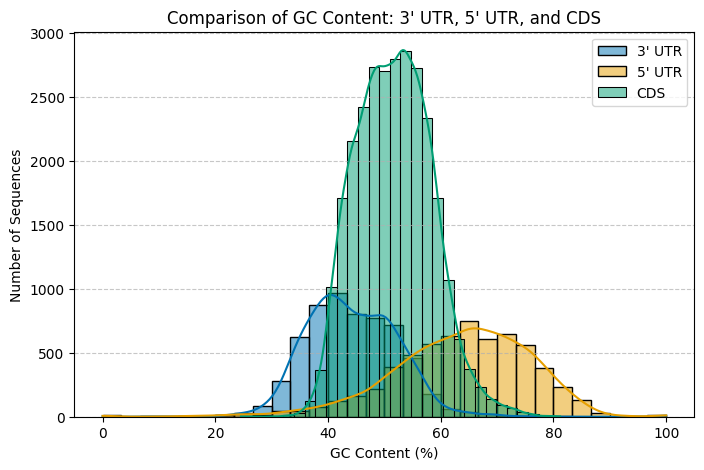

In [138]:
colors = ["#0072B2", "#E69F00", "#009E73"]  # Blue, Orange, Green

plt.figure(figsize=(8, 5))
sns.histplot(UTR3_GC_Content_df_sorted["GC_Content (%)"], bins=30, kde=True, color=colors[0], label="3' UTR", alpha=0.5)
sns.histplot(UTR5_GC_Content_df_sorted["GC_Content (%)"], bins=30, kde=True, color=colors[1], label="5' UTR", alpha=0.5)
sns.histplot(CDS_GC_Content_df_sorted["GC_Content (%)"], bins=30, kde=True, color=colors[2], label="CDS", alpha=0.5)

# Formatting
plt.xlabel("GC Content (%)")
plt.ylabel("Number of Sequences")
plt.title("Comparison of GC Content: 3' UTR, 5' UTR, and CDS")
plt.legend()
plt.grid(axis='y', linestyle='--', alpha=0.7)

plt.show()

In [139]:
UTR5_Length_df = UTR5_GC_Content_df[UTR5_GC_Content_df["Sequence"] != "Sequenceunavailable"]

In [140]:
UTR5_Length_df_sorted = UTR5_Length_df.sort_values(by="Length", ascending=False)

In [141]:
def codon_usage(seq):
    codons = [seq[i:i+3] for i in range(0, len(seq)-2, 3)]
    return Counter(codons)

In [142]:
CDS_GC_Content_df_sorted["Codon_Usage"] = CDS_GC_Content_df_sorted["Sequence"].apply(codon_usage)

In [143]:
CDS_GC_Content_df_sorted["Codon_Usage"]

9296     {'ATG': 1, 'CGG': 3, 'GGA': 3, 'TCG': 1, 'AGC'...
25166    {'GCA': 7, 'AGC': 4, 'CTC': 7, 'AGG': 5, 'GCT'...
10879    {'ATG': 2, 'TGC': 4, 'CCG': 3, 'TGT': 1, 'CCC'...
2246     {'TGG': 2, 'CTG': 6, 'GCC': 10, 'TAC': 2, 'CCG...
17213    {'ATG': 3, 'GCG': 22, 'GTG': 7, 'TCA': 1, 'CCG...
                               ...                        
25       {'ATG': 1, 'CCA': 2, 'CAA': 4, 'CTA': 3, 'GAC'...
15813    {'GTT': 1, 'GAA': 2, 'CAT': 2, 'TAC': 1, 'AAA'...
15019    {'ATG': 7, 'GAG': 3, 'TTG': 5, 'TCT': 3, 'GTT'...
28341    {'ATG': 4, 'GCC': 2, 'AAG': 5, 'AAC': 8, 'AAA'...
4709     {'TTG': 9, 'TGC': 1, 'AAT': 8, 'TAT': 6, 'TTT'...
Name: Codon_Usage, Length: 28327, dtype: object

In [144]:
cds_sequences = CDS_sequences_df[CDS_sequences_df["Sequence"] != "Sequenceunavailable"]
utr5_sequences = UTR5_sequences_df[UTR5_sequences_df["Sequence"] != "Sequenceunavailable"]
utr3_sequences = UTR3_sequences_df[UTR3_sequences_df["Sequence"] != "Sequenceunavailable"]

In [145]:
cds_sequences_dict = dict(zip(cds_sequences["ID"], cds_sequences["Sequence"]))
utr5_sequences_dict = dict(zip(utr5_sequences["ID"], utr5_sequences["Sequence"]))
utr3_sequences_dict = dict(zip(utr3_sequences["ID"], utr3_sequences["Sequence"]))

In [146]:
def extract_sequences(gene_list, seq_dict):
    """Extract sequences for a given gene list, handling identifier mismatches."""
    extracted_seqs = {}
    
    for key in seq_dict.keys():
        gene_symbol = key.split('|')[0]
        if gene_symbol in gene_list:
            extracted_seqs[gene_symbol] = seq_dict[key]

    return extracted_seqs

In [147]:
constitutive_gene_names = constitutive_genes[gene_col].tolist()

# Extract sequences
cds_constitutive = extract_sequences(constitutive_gene_names, cds_sequences_dict)
utr5_constitutive = extract_sequences(constitutive_gene_names, utr5_sequences_dict)
utr3_constitutive = extract_sequences(constitutive_gene_names, utr3_sequences_dict)

In [148]:
def save_fasta(sequences, filename):
    """Save sequences to a FASTA file."""
    with open(filename, "w") as f:
        for gene, seq in sequences.items():
            if seq:  # Ensure sequence is not empty
                f.write(f">{gene}\n{seq}\n")

# Save sequences
cds_fasta = "cds_constitutive.fasta"
utr5_fasta = "utr5_constitutive.fasta"
utr3_fasta = "utr3_constitutive.fasta"

save_fasta(cds_constitutive, cds_fasta)
save_fasta(utr5_constitutive, utr5_fasta)
save_fasta(utr3_constitutive, utr3_fasta)


In [149]:
#Remove short sequences since Meme fails for sequences shorter than length 6

def remove_short_sequences(input_file, output_file, min_length=6):
    """Remove sequences shorter than `min_length` and save the cleaned file."""
    with open(input_file, "r") as infile:
        lines = infile.readlines()
    
    cleaned_sequences = []
    current_header = None
    current_sequence = []
    
    with open(output_file, "w") as outfile:
        for line in lines:
            line = line.strip()
            if line.startswith(">"):  # Header line
                if current_header and len("".join(current_sequence)) >= min_length:
                    outfile.write(f"{current_header}\n{''.join(current_sequence)}\n")
                current_header = line  # Store new header
                current_sequence = []  # Reset sequence
            else:
                current_sequence.append(line.upper())  # Convert to uppercase and store
        
        # Write the last sequence if it's valid
        if current_header and len("".join(current_sequence)) >= min_length:
            outfile.write(f"{current_header}\n{''.join(current_sequence)}\n")

In [150]:
remove_short_sequences("cds_constitutive.fasta", "cds_final.fasta")
remove_short_sequences("utr5_constitutive.fasta", "utr5_final.fasta")
remove_short_sequences("utr3_constitutive.fasta", "utr3_final.fasta")

In [151]:
def check_sequence_lengths(file_path, min_length=6):
    """Check the length of all sequences in a FASTA file and print any that are too short."""
    short_sequences = []
    
    with open(file_path, "r") as f:
        current_header = None
        current_sequence = []

        for line in f:
            line = line.strip()
            if line.startswith(">"):
                if current_header and len("".join(current_sequence)) < min_length:
                    short_sequences.append((current_header, len("".join(current_sequence))))
                current_header = line  # Store new header
                current_sequence = []  # Reset sequence
            else:
                current_sequence.append(line.upper())

        if current_header and len("".join(current_sequence)) < min_length:
            short_sequences.append((current_header, len("".join(current_sequence))))

    return short_sequences


In [152]:
# Check for short sequences
short_cds = check_sequence_lengths("cds_final.fasta")
short_utr5 = check_sequence_lengths("utr5_final.fasta")
short_utr3 = check_sequence_lengths("utr3_final.fasta")

print("Short sequences in CDS:", short_cds)
print("Short sequences in UTR5:", short_utr5)
print("Short sequences in UTR3:", short_utr3)

Short sequences in CDS: []
Short sequences in UTR5: []
Short sequences in UTR3: []


In [153]:
def run_meme(input_fasta, output_dir, motif_length=6):
    """Run MEME with full path inside Python."""
    meme_path = "/Users/amritamoyade/meme/bin/meme"  # Full path to MEME
    if not os.path.exists(output_dir):
        os.makedirs(output_dir)

    command = f"{meme_path} {input_fasta} -oc {output_dir} -nmotifs 5 -minw {motif_length} -maxw {motif_length+4}"
    
    result = subprocess.run(command, shell=True, capture_output=True, text=True)
    
    print("MEME Output:", result.stdout)
    print("MEME Errors:", result.stderr)

In [154]:
# Run MEME
run_meme("cds_final.fasta", "meme_output_cds", motif_length=6)
run_meme("utr5_final.fasta", "meme_output_utr5", motif_length=6)
run_meme("utr3_final.fasta", "meme_output_utr3", motif_length=6)

MEME Output: 
MEME Errors: /bin/sh: /Users/amritamoyade/meme/bin/meme: No such file or directory

MEME Output: 
MEME Errors: /bin/sh: /Users/amritamoyade/meme/bin/meme: No such file or directory

MEME Output: 
MEME Errors: /bin/sh: /Users/amritamoyade/meme/bin/meme: No such file or directory



In [155]:
with open("meme_output_cds/meme.txt", "r") as f:
    found_motif = False
    for i, line in enumerate(f):
        if "MOTIF" in line:
            found_motif = True
        if found_motif:
            print(f"{i}: {line.strip()}")
        if i > 200:  # Stop after printing 200 lines
            break

67: MOTIF TGCTGCTG MEME-1	width =   8  sites = 281  llr = 3173  E-value = 3.0e+008
68: ********************************************************************************
69: --------------------------------------------------------------------------------
70: Motif TGCTGCTG MEME-1 Description
71: --------------------------------------------------------------------------------
72: Simplified        A  ::::::::
73: pos.-specific     C  ::a::a::
74: probability       D  ::::::::
75: matrix            E  ::::::::
76: F  ::::::::
77: G  :a::a::a
78: H  ::::::::
79: I  ::::::::
80: K  ::::::::
81: L  ::::::::
82: M  ::::::::
83: N  ::::::::
84: P  ::::::::
85: Q  ::::::::
86: R  ::::::::
87: S  ::::::::
88: T  a::a::a:
89: V  ::::::::
90: W  ::::::::
91: Y  ::::::::
92: 
93: bits   25.4
94: 22.9
95: 20.3
96: 17.8
97: Relative        15.2
98: Entropy         12.7
99: (16.3 bits)     10.2
100: 7.6
101: 5.1
102: 2.5 ********
103: 0.0 --------
104: 
105: Multilevel           TGCTGCTG
106: consensus

In [156]:
def parse_meme_results(output_dir):
    """Extract motif sequences and corresponding transcript IDs from MEME output."""
    motifs = []
    files = os.listdir(output_dir)
    meme_txt_file = next((f for f in files if f.endswith(".txt")), None)

    if meme_txt_file:
        meme_txt_file = os.path.join(output_dir, meme_txt_file)
        with open(meme_txt_file, "r") as f:
            lines = f.readlines()
            current_motif = None

            for line in lines:
                # Capture motif name
                if line.startswith("MOTIF"):
                    current_motif = line.strip()

                # Extract motif sequence and transcript ID from MEME output
                match = re.search(r"(\S+)\s+[\d.]+\s+\((\d+)\)\s+([ACGT]+)", line)
                if match and current_motif:
                    transcript_id, position, motif_seq = match.groups()
                    motifs.append((transcript_id, current_motif, motif_seq))

    return motifs


In [157]:

# Get motifs from MEME outputs
cds_motifs = pd.DataFrame(parse_meme_results("meme_output_cds"), 
                          columns=["ensembl_transcript_id", "Motif", "Motif_Sequence"])

utr5_motifs = pd.DataFrame(parse_meme_results("meme_output_utr5"), 
                           columns=["ensembl_transcript_id", "Motif", "Motif_Sequence"])

utr3_motifs = pd.DataFrame(parse_meme_results("meme_output_utr3"), 
                           columns=["ensembl_transcript_id", "Motif", "Motif_Sequence"])

In [158]:
df_motifs = pd.concat([cds_motifs, utr5_motifs, utr3_motifs], ignore_index=True)

df_motifs["Region"] = (
    ["CDS"] * len(cds_motifs) + ["5' UTR"] * len(utr5_motifs) + ["3' UTR"] * len(utr3_motifs)
)

In [159]:
print(df_motifs.columns)
print(expression_corrected_df.columns)

Index(['ensembl_transcript_id', 'Motif', 'Motif_Sequence', 'Region'], dtype='object')
Index(['ensembl_transcript_id', 'sym', 'ensembl_peptide_id', 'SRR3401749',
       'SRR3401751', 'SRR3401745', 'SRR3401747', 'SRR3401746', 'SRR3401748',
       'SRR3401750', 'SRR3401752', 'ERR7417863', 'ERR7417867', 'ERR7417864',
       'ERR7417870', 'ERR7417865', 'ERR7417866', 'ERR7417869', 'ERR7417868',
       'SRR22810193', 'SRR22810194', 'SRR22810191', 'SRR22810192',
       'SRR22810189', 'SRR22810190', 'SRR11184908', 'SRR11184909',
       'SRR11184911', 'SRR11184915', 'SRR11184916', 'SRR11184910',
       'SRR11184912', 'SRR11184917', 'SRR11184918', 'SRR11184913',
       'SRR11184914', 'SRR11184919', 'SRR11184920', 'SRR11184921',
       'SRR10572658', 'SRR10572659', 'SRR10572660', 'SRR10572663',
       'SRR10572664', 'SRR10572657', 'SRR10572661', 'SRR10572662',
       'SRR3401399', 'SRR3401401', 'SRR5812574', 'SRR5812577', 'SRR5812581',
       'SRR5812564', 'SRR5812565', 'SRR5812569', 'SRR5812580',

In [160]:
df_combined = expression_corrected_df.merge(df_motifs, on="ensembl_transcript_id", how="left")

df_combined["Motif_Sequence"] = df_combined["Motif_Sequence"].fillna("No Motif")

print(df_combined.head())

  ensembl_transcript_id                 sym  ensembl_peptide_id  SRR3401749  \
0    ENSCGRT00001000002  ENSCGRG00001000002          non-coding   -0.862044   
1    ENSCGRT00001000004  ENSCGRG00001000004          non-coding    2.090503   
2    ENSCGRT00001000005  ENSCGRG00001000005          non-coding   -0.862044   
3    ENSCGRT00001000006                 ND1  ENSCGRP00001000001    2.314180   
4    ENSCGRT00001000008  ENSCGRG00001000008          non-coding   -0.854626   

   SRR3401751  SRR3401745  SRR3401747  SRR3401746  SRR3401748  SRR3401750  \
0   -0.841171   -0.802193   -0.842113   -0.820148   -0.837184   -0.868607   
1    1.759704    1.725354    2.005213    2.026904    2.240531    2.159483   
2   -0.841171   -0.802193   -0.842113   -0.820148   -0.837184   -0.868607   
3    2.117022    2.280825    2.203470    2.390234    2.302703    2.424949   
4   -0.675732   -0.813499   -0.840931   -0.825838   -0.837544   -0.859136   

   ...  SRR18502229  SRR18502230  SRR18502233  mean_expression

#### Find Which Motifs Are Most Frequent

In [161]:
df_motifs["Sites"] = df_motifs["Motif"].str.extract(r"sites = (\d+)", expand=False).astype(float)
df_motifs_sorted = df_motifs.sort_values(by="Sites", ascending=False)
df_motifs_sorted

,ensembl_transcript_id,Motif,Motif_Sequence,Region,Sites


In [162]:
df_motifs_sorted["Motif_Short"] = df_motifs_sorted["Motif"].str.extract(r"(MOTIF\s+\S+)")

In [163]:
# Create a mapping from sequences to transcript IDs
sequence_to_transcript = {}

# Add sequences from all regions to the mapping
for df in [UTR3_sequences_df, UTR5_sequences_df, CDS_sequences_df]:
    for index, row in df.iterrows():
        transcript_id = row["ID"].split('|')[0]
        sequence = row["Sequence"].strip()

        if sequence != "Sequenceunavailable":
            sequence_to_transcript[transcript_id] = sequence

In [164]:
for motif_seq in df_motifs_sorted["Motif_Sequence"].head(10):
    found = any(motif_seq in seq for seq in sequence_to_transcript.values())
    print(motif_seq, "Found in transcript sequences:", found)

In [165]:
# Function to match MEME motifs to transcript IDs
def map_motifs_to_transcripts(meme_motif_sequences, sequence_mapping):
    motif_transcript_mapping = []
    
    for motif_seq in meme_motif_sequences:
        # Find the corresponding transcript by matching sequences
        matched_transcript = sequence_mapping.get(motif_seq, "Unknown")
        motif_transcript_mapping.append((motif_seq, matched_transcript))

    return motif_transcript_mapping

In [166]:
meme_motif_transcript_map = map_motifs_to_transcripts(df_motifs_sorted, sequence_to_transcript)

# Convert to DataFrame
df_meme_transcript_mapped = pd.DataFrame(meme_motif_transcript_map, columns=["Motif_Sequence", "ensembl_transcript_id"])

In [167]:
fimo_cds = pd.read_csv("fimo_output_cds/fimo.tsv", sep="\t")
fimo_utr5 = pd.read_csv("fimo_output_utr5/fimo.tsv", sep="\t")
fimo_utr3 = pd.read_csv("fimo_output_utr3/fimo.tsv", sep="\t")

In [168]:
# Merge FIMO results with expression data
df_fimo_cds = fimo_cds.merge(expression_corrected_df, left_on="sequence_name", right_on="ensembl_transcript_id", how="left")
df_fimo_utr5 = fimo_utr5.merge(expression_corrected_df, left_on="sequence_name", right_on="ensembl_transcript_id", how="left")
df_fimo_utr3 = fimo_utr3.merge(expression_corrected_df, left_on="sequence_name", right_on="ensembl_transcript_id", how="left")

# Combine all FIMO results into one dataframe
df_fimo_combined = pd.concat([df_fimo_cds, df_fimo_utr5, df_fimo_utr3], ignore_index=True)

# Display merged data
display(df_fimo_combined.head())

,motif_id,motif_alt_id,sequence_name,start,stop,strand,score,p-value,q-value,matched_sequence,...,SRR18502224,SRR18502225,SRR18502226,SRR18502229,SRR18502230,SRR18502233,mean_expression,variance,CV,MAD
0,CTGCTGCT,MEME-2,ENSCGRT00001005690,4.0,11.0,+,37.2857,6.040000e-12,8.090000e-09,CTGCTGCT,...,-0.801082,-0.811226,-0.810042,-0.821435,-0.829250,-0.831469,-0.825069,0.000584,-0.000707,0.018578
1,CTGCTGCT,MEME-2,ENSCGRT00001025902,4.0,11.0,+,37.2857,6.040000e-12,8.090000e-09,CTGCTGCT,...,0.011901,0.290137,0.131251,0.375157,0.430441,0.246542,0.318097,0.022477,0.070660,0.099215
2,CTGCTGCT,MEME-2,ENSCGRT00001007981,4.0,11.0,+,37.2857,6.040000e-12,8.090000e-09,CTGCTGCT,...,-0.813652,-0.820819,-0.819982,-0.828032,-0.833553,-0.835120,-0.830963,0.000171,-0.000206,0.009377
3,CTGCTGCT,MEME-2,ENSCGRT00001032399,4.0,11.0,+,37.2857,6.040000e-12,8.090000e-09,CTGCTGCT,...,1.681980,1.668534,1.710376,1.594833,1.607112,1.594131,1.644373,0.003014,0.001833,0.038740
4,CTGCTGCT,MEME-2,ENSCGRT00001025916,4.0,11.0,+,37.2857,6.040000e-12,8.090000e-09,CTGCTGCT,...,0.748755,0.735636,0.767253,0.910207,0.899404,0.970674,0.896004,0.005478,0.006114,0.049828


In [169]:
genes_with_motif_hits = df_fimo_combined["sequence_name"].nunique()
total_constitutive_genes = 25594  # from your earlier output

percent_with_motifs = (genes_with_motif_hits / total_constitutive_genes) * 100
print(f"Motifs found in {genes_with_motif_hits} out of {total_constitutive_genes} constitutive genes ({percent_with_motifs:.1f}%)")

Motifs found in 23370 out of 25594 constitutive genes (91.3%)


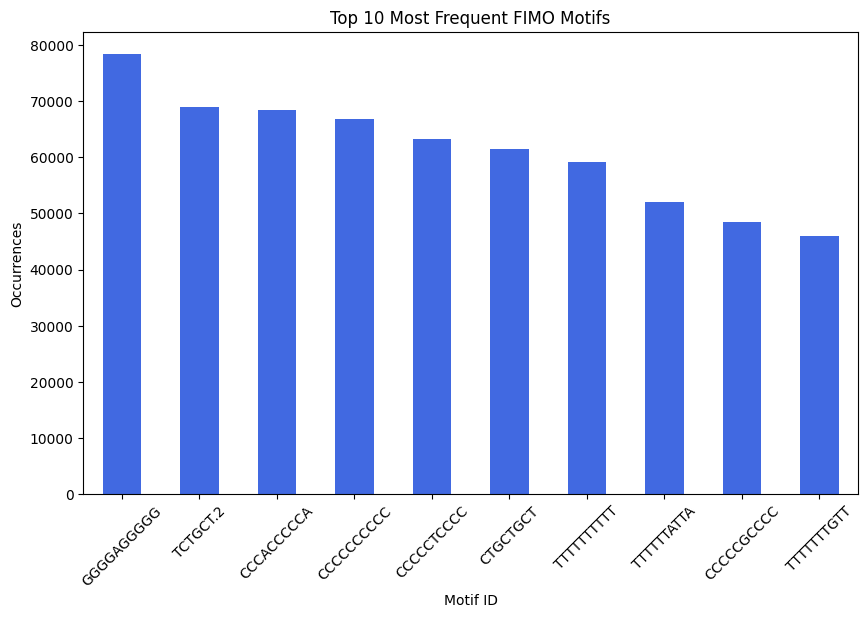

In [170]:
top_motifs = df_fimo_combined["motif_id"].value_counts().head(10)

plt.figure(figsize=(10, 6))
top_motifs.plot(kind="bar", color="royalblue")
plt.xlabel("Motif ID")
plt.ylabel("Occurrences")
plt.title("Top 10 Most Frequent FIMO Motifs")
plt.xticks(rotation=45)
plt.show()

## DNA Bert

In [171]:
# Set device
device = torch.device("mps") if torch.backends.mps.is_available() else torch.device("cpu")
print(f"Using device: {device}")

# Load DNABERT 6-mer model
tokenizer = AutoTokenizer.from_pretrained(
    "zhihan1996/DNA_bert_6",
    trust_remote_code=True
)

model = AutoModel.from_pretrained(
    "zhihan1996/DNA_bert_6",
    trust_remote_code=True
)

# Move model to device
model = model.to(device)

# Set model to eval mode
model.eval()

Using device: mps


BertModel(
  (embeddings): BertEmbeddings(
    (word_embeddings): Embedding(4101, 768, padding_idx=0)
    (position_embeddings): Embedding(512, 768)
    (token_type_embeddings): Embedding(2, 768)
    (LayerNorm): LayerNorm((768,), eps=1e-12, elementwise_affine=True)
    (dropout): Dropout(p=0.1, inplace=False)
  )
  (encoder): BertEncoder(
    (layer): ModuleList(
      (0-11): 12 x BertLayer(
        (attention): BertAttention(
          (self): BertSdpaSelfAttention(
            (query): Linear(in_features=768, out_features=768, bias=True)
            (key): Linear(in_features=768, out_features=768, bias=True)
            (value): Linear(in_features=768, out_features=768, bias=True)
            (dropout): Dropout(p=0.1, inplace=False)
          )
          (output): BertSelfOutput(
            (dense): Linear(in_features=768, out_features=768, bias=True)
            (LayerNorm): LayerNorm((768,), eps=1e-12, elementwise_affine=True)
            (dropout): Dropout(p=0.1, inplace=False)

In [172]:
file_path = "StudMAt/5UTR_sequences.fasta"

utr5_sequences = {
    record.id.split('|')[0]: str(record.seq) 
    for record in SeqIO.parse(file_path, "fasta")
}

utr3_sequences = {
    record.id.split('|')[0]: str(record.seq)
    for record in SeqIO.parse("StudMAt/3UTR_sequences.fasta", "fasta")
}

cds_sequences = {
    record.id.split('|')[0]: str(record.seq)
    for record in SeqIO.parse("StudMAt/CDS_sequences.fasta", "fasta")
}

In [173]:
def get_dnabert_embedding(sequence):
    inputs = tokenizer(
        sequence,
        return_tensors="pt",
        truncation=True,
        max_length=512,
        padding=True
    )
    
    inputs = {k: v.to(device) for k, v in inputs.items()}
    
    with torch.no_grad():
        outputs = model(**inputs)
    
    embedding = outputs.last_hidden_state.mean(dim=1)
    
    return embedding.squeeze().cpu().numpy()

In [174]:
utr5_embeddings = []

for gene_id in tqdm(utr5_constitutive):  
    if gene_id in utr5_sequences:
        seq = utr5_sequences[gene_id]
        emb = get_dnabert_embedding(seq)
        utr5_embeddings.append((gene_id, emb))

utr5_emb_df = pd.DataFrame(
    [emb for _, emb in utr5_embeddings],
    index=[gene_id for gene_id, _ in utr5_embeddings]
)

utr5_emb_df.index.name = "ensembl_transcript_id"
utr5_emb_df.to_csv("utr5_dnabert_embeddings.csv")

100%|███████████████████████████████████████| 6181/6181 [01:12<00:00, 85.07it/s]


In [175]:
utr3_embeddings = []

for gene_id in tqdm(utr3_constitutive):
    if gene_id in utr3_sequences:
        seq = utr3_sequences[gene_id]
        emb = get_dnabert_embedding(seq)
        utr3_embeddings.append((gene_id, emb))

utr3_emb_df = pd.DataFrame(
    [emb for _, emb in utr3_embeddings],
    index=[gene_id for gene_id, _ in utr3_embeddings]
)

utr3_emb_df.index.name = "ensembl_transcript_id"
utr3_emb_df.to_csv("utr3_dnabert_embeddings.csv")

100%|███████████████████████████████████████| 5948/5948 [01:11<00:00, 83.64it/s]


In [176]:
cds_embeddings = []

for gene_id in tqdm(cds_constitutive):
    if gene_id in cds_sequences:
        seq = cds_sequences[gene_id]
        emb = get_dnabert_embedding(seq)
        cds_embeddings.append((gene_id, emb))

cds_emb_df = pd.DataFrame(
    [emb for _, emb in cds_embeddings],
    index=[gene_id for gene_id, _ in cds_embeddings]
)

cds_emb_df.index.name = "ensembl_transcript_id"
cds_emb_df.to_csv("cds_dnabert_embeddings.csv")

100%|█████████████████████████████████████| 24667/24667 [05:00<00:00, 82.00it/s]


In [177]:
# Combine all three FIMO outputs
fimo_all = pd.concat([fimo_cds, fimo_utr5, fimo_utr3], ignore_index=True)

# Create binary presence matrix
motif_presence = fimo_all[["matched_sequence", "sequence_name"]].drop_duplicates()

# Pivot to wide format
motif_presence_df = pd.crosstab(
    motif_presence["sequence_name"],
    motif_presence["matched_sequence"]
)

In [178]:
# Extract expression sample columns
expression_cols = [col for col in expression_corrected_df.columns if col.startswith("SRR")]

# Calculate mean expression per gene
expression_corrected_df["mean_expression"] = expression_corrected_df[expression_cols].mean(axis=1)

# Build Series mapping gene ID to mean expression
gene_expression = expression_corrected_df.set_index("ensembl_transcript_id")["mean_expression"]

gene_expression = gene_expression.drop("PRODUCT-TG", errors="ignore")

In [179]:
results = []

for motif in motif_presence_df.columns:
    present_genes = motif_presence_df.index[motif_presence_df[motif] == 1]
    absent_genes = motif_presence_df.index[motif_presence_df[motif] == 0]
    
    if len(present_genes) < 5 or len(absent_genes) < 5:
        continue
    
    mean_present = gene_expression.loc[present_genes].mean()
    mean_absent = gene_expression.loc[absent_genes].mean()
    
    # Fold change calculation
    fold_change = mean_present / mean_absent if mean_absent != 0 else None
    
    results.append({
        "Motif": motif,
        "Mean_Expr_Present": mean_present,
        "Mean_Expr_Absent": mean_absent,
        "Fold_Change": fold_change,
        "Present_Genes": len(present_genes)
    })

motif_activity_df = pd.DataFrame(results)
motif_activity_df = motif_activity_df.dropna().sort_values(by="Fold_Change", ascending=False)

display(motif_activity_df.head(10))

,Motif,Mean_Expr_Present,Mean_Expr_Absent,Fold_Change,Present_Genes
12387,TTTGGCTTCT,-0.830908,-0.040180,20.679605,6
465,ACCACACCCG,-0.830908,-0.040214,20.662202,5
5462,CGGGAGAGGT,-0.830908,-0.040214,20.662202,5
5388,CGCCCTGTCC,-0.830908,-0.040214,20.662202,5
3062,CCCACCCGTG,-0.830395,-0.040214,20.649370,5
11097,TGAAAGTTGA,-0.830387,-0.040214,20.649176,5
4155,CCCGCCCTGG,-0.830351,-0.040214,20.648287,5
1807,CACCCGCCCT,-0.829177,-0.040214,20.618956,5
11546,TGGGTTTCTG,-0.828926,-0.040214,20.612684,5
6141,CTGTTTTGAG,-0.826675,-0.040114,20.608223,8


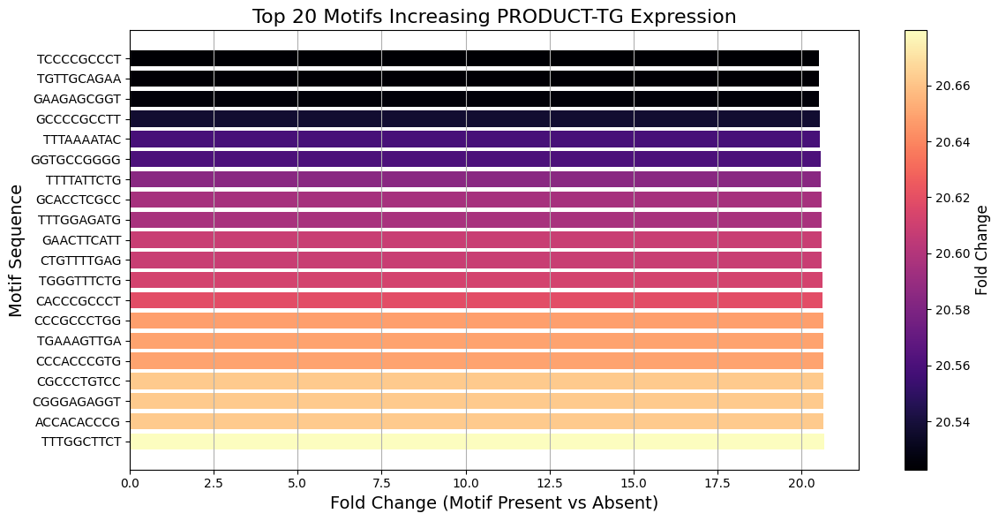

In [180]:
top_motifs = motif_activity_df[motif_activity_df["Fold_Change"] > 1.0].head(20)

norm = plt.Normalize(top_motifs["Fold_Change"].min(), top_motifs["Fold_Change"].max())
colors = cm.magma(norm(top_motifs["Fold_Change"]))  # Use normalized values

fig, ax = plt.subplots(figsize=(12,6))

bars = ax.barh(
    top_motifs["Motif"],
    top_motifs["Fold_Change"],
    color=colors
)

sm = plt.cm.ScalarMappable(cmap="magma", norm=norm)
sm.set_array([])  # Hack required for matplotlib

cbar = fig.colorbar(sm, ax=ax)
cbar.set_label("Fold Change", fontsize=12)

ax.set_xlabel("Fold Change (Motif Present vs Absent)", fontsize=14)
ax.set_ylabel("Motif Sequence", fontsize=14)
ax.set_title("Top 20 Motifs Increasing PRODUCT-TG Expression", fontsize=16)
ax.grid(True, axis="x")

plt.tight_layout()
plt.show()

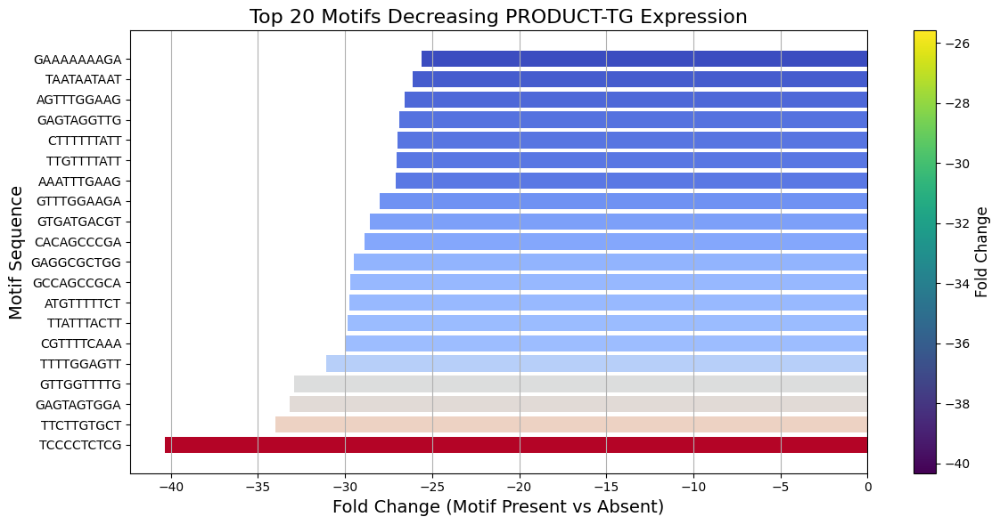

In [181]:
down_motifs = motif_activity_df[motif_activity_df["Fold_Change"] < 1.0].sort_values(by="Fold_Change").head(20)

norm = mcolors.Normalize(vmin=down_motifs["Fold_Change"].min(), vmax=down_motifs["Fold_Change"].max())
colors = cm.coolwarm_r(norm(down_motifs["Fold_Change"]))  # Reverse colormap for clarity

fig, ax = plt.subplots(figsize=(12, 6))

bars = ax.barh(
    down_motifs["Motif"],
    down_motifs["Fold_Change"],
    color=colors
)

sm = plt.cm.ScalarMappable(cmap="viridis", norm=norm)
sm.set_array([])
cbar = fig.colorbar(sm, ax=ax)
cbar.set_label("Fold Change", fontsize=12)

ax.set_xlabel("Fold Change (Motif Present vs Absent)", fontsize=14)
ax.set_ylabel("Motif Sequence", fontsize=14)
ax.set_title("Top 20 Motifs Decreasing PRODUCT-TG Expression", fontsize=16)
ax.grid(True, axis="x")

plt.tight_layout()
plt.savefig("Top_20_Motifs_Downregulated.png", dpi=300)
plt.show()

In [182]:
# Combine all FIMO outputs
fimo_all = pd.concat([fimo_cds, fimo_utr5, fimo_utr3], ignore_index=True)

# Create binary presence matrix
motif_presence = fimo_all[["matched_sequence", "sequence_name", "p-value"]].drop_duplicates()

# Merge p-values into your motif_activity_df

# Get minimum p-value for each (sequence, motif) pair
min_pvalues = motif_presence.groupby("matched_sequence")["p-value"].min()

# Merge p-value back into motif_activity_df
motif_activity_df["Min_PValue"] = motif_activity_df["Motif"].map(min_pvalues)

# Apply full filtering based on 3 conditions:
filtered_motifs = motif_activity_df[
    (motif_activity_df["Present_Genes"] >= 5) &     # Seen in >= 5 genes
    (motif_activity_df["Min_PValue"] <= 0.05) &      # p-value <= 0.05
    (motif_activity_df["Fold_Change"].notna())       # Fold-change available
]

# Separate Upregulating vs Downregulating motifs
up_motifs = filtered_motifs[
    (filtered_motifs["Fold_Change"] >= 1.5)          # Increase expression by >=50%
].sort_values(by="Fold_Change", ascending=False)

down_motifs = filtered_motifs[
    (filtered_motifs["Fold_Change"] <= 0.67)         # Decrease expression by >=33%
].sort_values(by="Fold_Change", ascending=True)

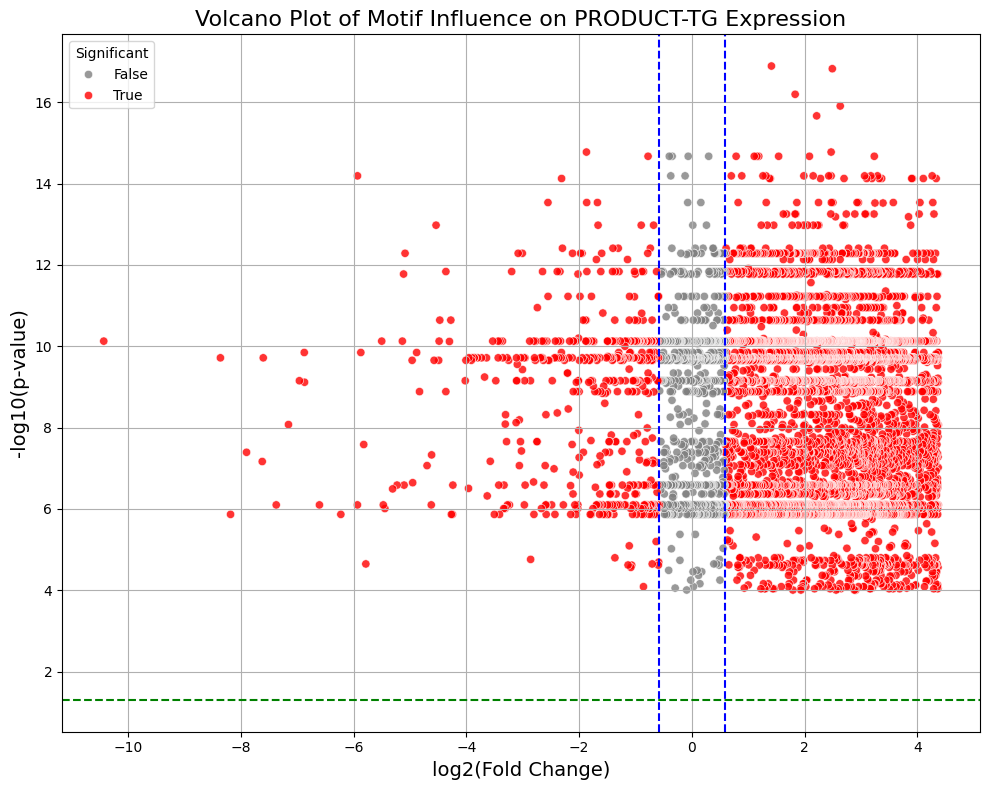

In [183]:
volcano_df = filtered_motifs.copy()

# Compute log2 Fold Change and -log10 p-value
volcano_df["log2FoldChange"] = np.log2(volcano_df["Fold_Change"])
volcano_df["neg_log10_pvalue"] = -np.log10(volcano_df["Min_PValue"])

# Define significant points
volcano_df["Significant"] = (
    (volcano_df["Min_PValue"] <= 0.05) &
    ((volcano_df["Fold_Change"] >= 1.5) | (volcano_df["Fold_Change"] <= 0.67))
)

plt.figure(figsize=(10,8))
sns.scatterplot(
    data=volcano_df,
    x="log2FoldChange",
    y="neg_log10_pvalue",
    hue="Significant",
    palette={True: "red", False: "grey"},
    alpha=0.8
)

plt.axvline(np.log2(1.5), color="blue", linestyle="--")  # Upregulation cutoff
plt.axvline(np.log2(0.67), color="blue", linestyle="--")  # Downregulation cutoff
plt.axhline(-np.log10(0.05), color="green", linestyle="--")  # P-value cutoff

plt.title("Volcano Plot of Motif Influence on PRODUCT-TG Expression", fontsize=16)
plt.xlabel("log2(Fold Change)", fontsize=14)
plt.ylabel("-log10(p-value)", fontsize=14)
plt.legend(title="Significant", loc="upper left")
plt.grid(True)
plt.tight_layout()
plt.show()

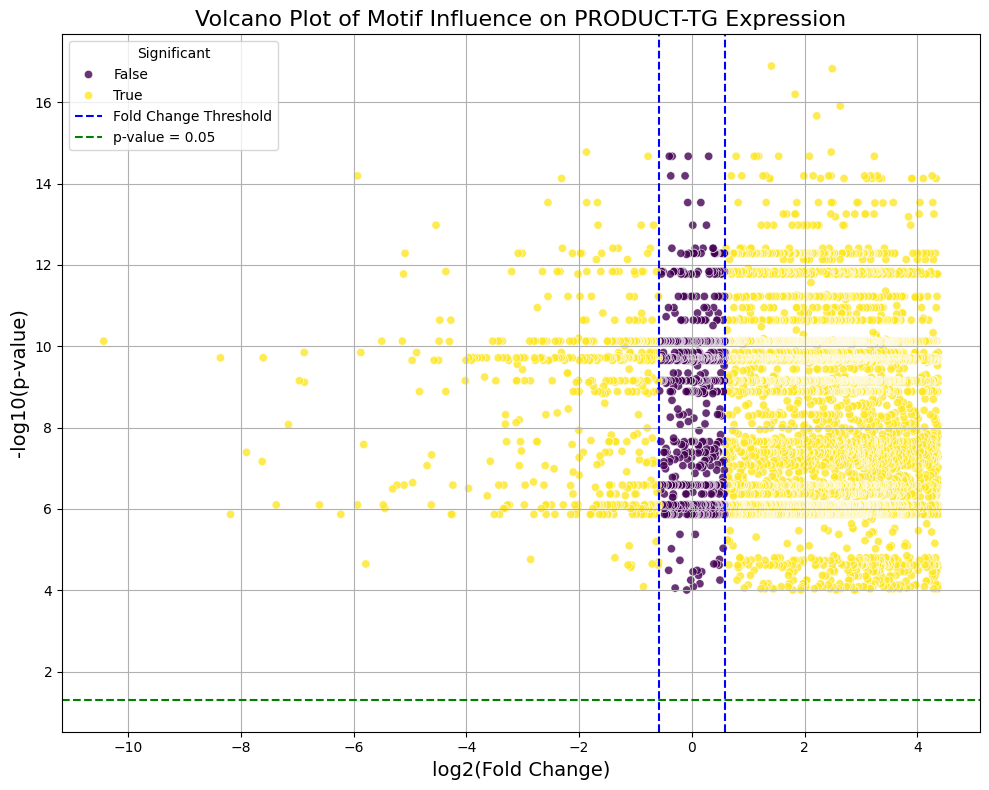

In [184]:
viridis = cm.get_cmap("viridis", 2)
colors = {
    True: viridis(1.0),   # Bright end of viridis for significant
    False: viridis(0.3)   # Dimmer viridis tone for non-significant
}

# Plot
plt.figure(figsize=(10, 8))
sns.scatterplot(
    data=volcano_df,
    x="log2FoldChange",
    y="neg_log10_pvalue",
    hue="Significant",
    palette=colors,
    alpha=0.8
)

# Threshold lines
plt.axvline(np.log2(1.5), color="blue", linestyle="--", label="Fold Change Threshold")
plt.axvline(np.log2(0.67), color="blue", linestyle="--")
plt.axhline(-np.log10(0.05), color="green", linestyle="--", label="p-value = 0.05")

# Labels and title
plt.title("Volcano Plot of Motif Influence on PRODUCT-TG Expression", fontsize=16)
plt.xlabel("log2(Fold Change)", fontsize=14)
plt.ylabel("-log10(p-value)", fontsize=14)
plt.legend(title="Significant", loc="upper left")
plt.grid(True)
plt.tight_layout()
plt.savefig("Motif_Influence_Volcano_Plot_ViridisBinary.png", dpi=300)
plt.show()